In [50]:
import traceback
import json
import os
import shutil
from pprint import pprint
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from pynwb import NWBHDF5IO

import spikeinterface

import spikeinterface.full as si  # import core only
import spikeinterface.extractors as se
import spikeinterface.sorters as ss
import spikeinterface.comparison as sc
import spikeinterface.widgets as sw
import spikeinterface.qualitymetrics as sqm
import spikeinterface.postprocessing as spost
from spikeinterface import WaveformExtractor
from spikeinterface.comparison import MultiSortingComparison

from probeinterface.plotting import plot_probe

from pathlib import Path

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['font.size'] = '5'


from utils import firingrates_from_sorting, check_available_sorter_results
from utils import load_sortings_from_sorters, save_qm_fr_results, load_qm_fr_results

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


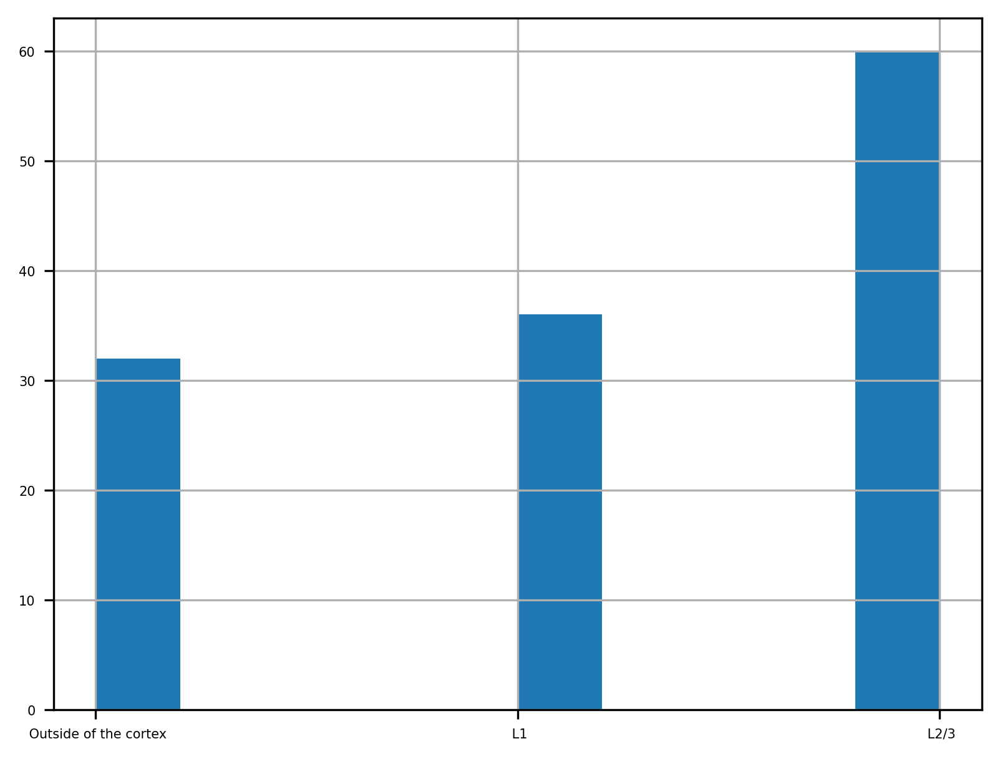

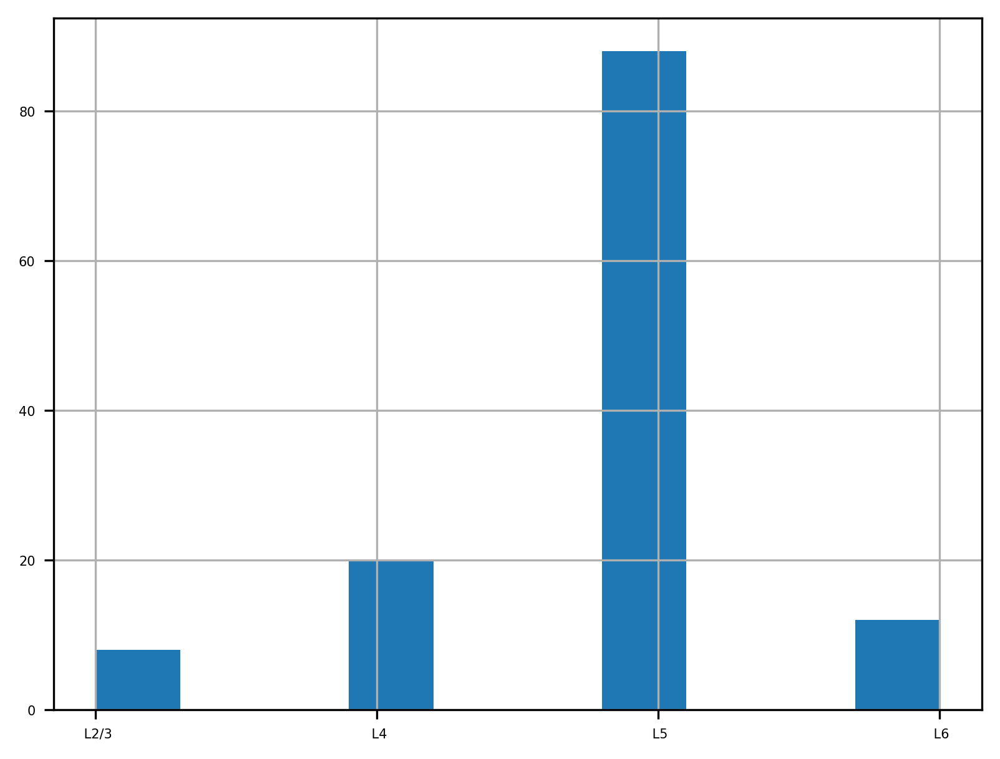

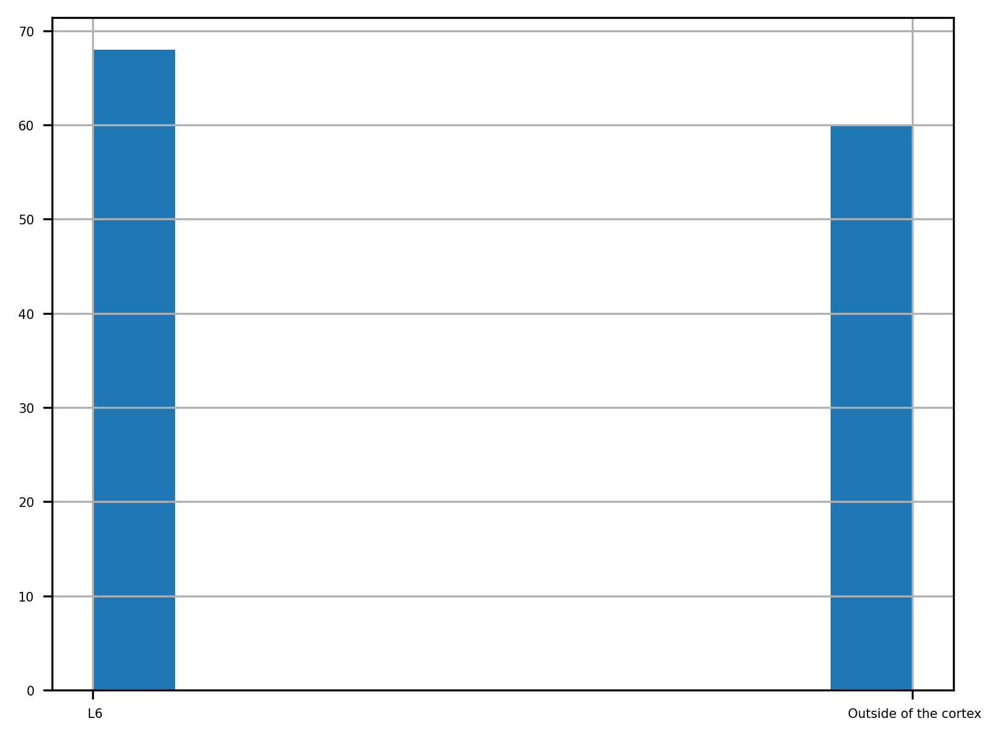

In [2]:
# showing the distruibution of contacts in cortical layers for all depths

nwbpath = '../../../scratch/imbeni/sorting/dataset/horvath/Rat01/Insertion1/'

recs = {}
for i in [1,2,3]:
    datapath = '../../../scratch/imbeni/sorting/dataset/horvath/Rat01/Insertion1/' + 'Depth' + str(i) +'/'
    filename = 'Rat01_Insertion1_Depth'+str(i)+'.nwb' 
    io = NWBHDF5IO(datapath + filename, mode="r")
    nwbfile = io.read()
    df = nwbfile.electrodes.to_dataframe()
    location = df.location.apply(lambda x: x.decode("utf-8").split(',')[-1])
    location.hist()
    plt.show()

In [3]:
i = 2
datapath = '../../../scratch/imbeni/sorting/dataset/horvath/Rat01/Insertion1/' + 'Depth' + str(i) +'/'
outpath = '../../../scratch/imbeni/sorting/output/1_horvath/Rat01/Insertion1/' + 'Depth' + str(i) +'/'
filename = 'Rat01_Insertion1_Depth'+str(i)+'.nwb' 
name = filename[:-4]
out = outpath + name
outrec = out + '_rec'


In [33]:
sorters = check_available_sorter_results(out)
print(sorters)

['hdsort', 'herdingspikes', 'ironclust', 'kilosort3', 'spykingcircus2', 'tridesclous2']


In [5]:
# example paths
sorter = 'kilosort3'
sorteroutput =  out + str(sorter)

rec_folder =  outrec
sort_folder =  out + str(sorter) + '_spikes'
we_folder = out + str(sorter) + '_wfs'

In [6]:
recording = spikeinterface.load_extractor(outrec) # preprocessed

In [7]:
channel_ids=recording.get_channel_ids()
channel_ids

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128])

(<matplotlib.collections.PolyCollection at 0x7fffbcad4d90>,
 <matplotlib.collections.PolyCollection at 0x7ff4dbaa5190>)

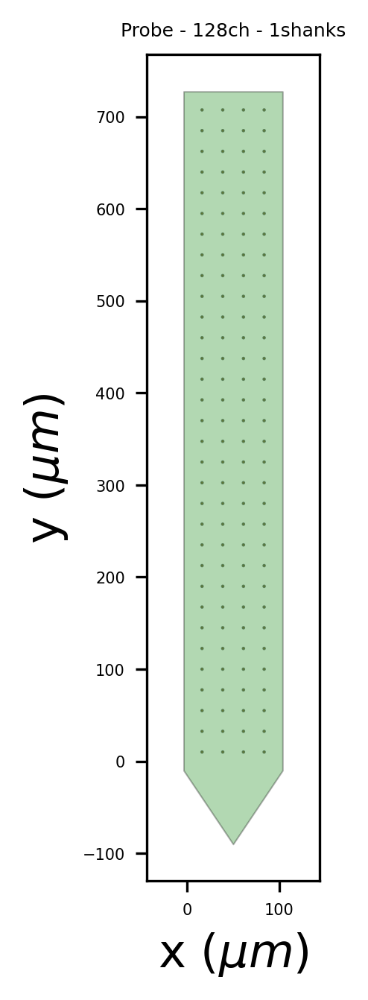

In [8]:
probe = recording.get_probe()
probe.create_auto_shape(probe_type='tip')
plot_probe(probe)

NWB file name,NWB file size (GB),Recording duration (min),Cortical area,Single unit yield,Average signal-to-noise ratio of single units,Power spectral density at 50 Hz (dB/Hz),50 Hz/49 Hz ratio,RMS noise level (300 - 6000 Hz),RMS signal level (300 - 6000 Hz)
Rat01_Insertion1_Depth1,13.02,60.11,S1HL,66,12.88,47.39,1.83,8.61,12.22
Rat01_Insertion1_Depth2,13.39,61.48,S1HL,91,8.29,47.33,1.70,8.57,18.38
Rat01_Insertion1_Depth3,13.01,60.05,S1HL,50,8.54,47.28,1.78,9.58,15.55

In [9]:
io = NWBHDF5IO(datapath + filename, mode="r")
nwbfile = io.read()
layers_map = [loc.decode("utf-8").split(',')[1][-1] for loc in nwbfile.electrodes.to_dataframe().location]
contact_ids = nwbfile.electrodes.id[:]
contact_layers = dict(zip(contact_ids.flatten(), layers_map))

In [10]:
contact_layers

{1: '3',
 2: '3',
 3: '3',
 4: '3',
 5: '3',
 6: '3',
 7: '3',
 8: '3',
 9: '4',
 10: '4',
 11: '4',
 12: '4',
 13: '4',
 14: '4',
 15: '4',
 16: '4',
 17: '4',
 18: '4',
 19: '4',
 20: '4',
 21: '4',
 22: '4',
 23: '4',
 24: '4',
 25: '4',
 26: '4',
 27: '4',
 28: '4',
 29: '5',
 30: '5',
 31: '5',
 32: '5',
 33: '5',
 34: '5',
 35: '5',
 36: '5',
 37: '5',
 38: '5',
 39: '5',
 40: '5',
 41: '5',
 42: '5',
 43: '5',
 44: '5',
 45: '5',
 46: '5',
 47: '5',
 48: '5',
 49: '5',
 50: '5',
 51: '5',
 52: '5',
 53: '5',
 54: '5',
 55: '5',
 56: '5',
 57: '5',
 58: '5',
 59: '5',
 60: '5',
 61: '5',
 62: '5',
 63: '5',
 64: '5',
 65: '5',
 66: '5',
 67: '5',
 68: '5',
 69: '5',
 70: '5',
 71: '5',
 72: '5',
 73: '5',
 74: '5',
 75: '5',
 76: '5',
 77: '5',
 78: '5',
 79: '5',
 80: '5',
 81: '5',
 82: '5',
 83: '5',
 84: '5',
 85: '5',
 86: '5',
 87: '5',
 88: '5',
 89: '5',
 90: '5',
 91: '5',
 92: '5',
 93: '5',
 94: '5',
 95: '5',
 96: '5',
 97: '5',
 98: '5',
 99: '5',
 100: '5',
 101: '5

# Extracting firing rates from individual sorters

In [11]:
sorters_fr_results = {}
qmetrics = {}
for sorter in sorters:
    sort_folder =  out + str(sorter) + '_spikes'
    we_folder = out + str(sorter) + '_wfs'
    print(sorter)
    sorting = si.load_extractor(sort_folder)
    print(sorting)
    try:
        we = WaveformExtractor.load_from_folder(we_folder)
        print('Computing metrics')
        qm = sqm.compute_quality_metrics(we, progress_bar=True)
        print('Done with metrics')
    except: # if the loading of waveforms fails, compute them
        rec = si.load_extractor(outrec)
        print('Extracting waveforms')
        we = si.extract_waveforms(rec, sorting, we_folder,
                          load_if_exists=False, overwrite=True,
                          ms_before=2, ms_after=2, max_spikes_per_unit=None, verbose = True, n_jobs = 10, total_memory = '60G')
        qm = sqm.compute_quality_metrics(we)
    print('Computing frs')
    qm,rates_per_layer = firingrates_from_sorting(sorting,we,qm, contact_layers)
    print('Done with', sorter)
    qmetrics[sorter] = qm
    sorters_fr_results[sorter] = rates_per_layer

hdsort
NpzSortingExtractor: 119 units - 1 segments - 20.0kHz
  file_path: /gpfs/bbp.cscs.ch/data/scratch/proj68/imbeni/sorting/output/1_horvath/Rat01/Insertion1/Depth2/Rat01_Insertion1_Depth2hdsort_spikes/sorting_cached.npz


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/spikeinterface/extractors/hdsortextractors.py:250: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  while not isinstance(ds, (int, float, np.integer, np.float)):
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/spikeinterface/extractors/hdsortextractors.py:250: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdo

Computing metrics
Extracting waveforms


KeyboardInterrupt: 

In [ ]:
save_qm_fr_results(out, sorters_fr_results, qmetrics)

In [ ]:
qmetrics, sorters_fr_results = load_qm_fr_results(out, sorters)

metrics = {
    "num_spikes" : compute_num_spikes,
    "firing_rate" : compute_firing_rate,
    "presence_ratio" : compute_presence_ratio,
    "snr" : compute_snrs,
    "isi_violation" : compute_isi_violations,
    "amplitude_cutoff" : compute_amplitudes_cutoff, 
    'mahalanobis_metrics' : mahalanobis_metrics,
    'd_prime' : lda_metrics,
    'nearest_neighbor' : nearest_neighbors_metrics,
    'nn_isolation' : nearest_neighbors_isolation,
    'nn_noise_overlap' : nearest_neighbors_noise_overlap}

# Comparison

In [34]:
sortings, sorters_to_compare = load_sortings_from_sorters(out,sorters)

Loaded hdsort with units = 119
Loaded herdingspikes with units = 108
Loaded ironclust with units = 68
Loaded kilosort3 with units = 178
Loaded spykingcircus2 with units = 0
Excluding spykingcircus2


In [39]:
mcmp = sc.compare_multiple_sorters(
    sorting_list=sortings,
    name_list=sorters_to_compare,
    verbose=True,
)

mcmp.save_to_folder(out + '_comparison')

Multicomaprison step 1: pairwise comparison
  Comparing: hdsort and herdingspikes


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


  Comparing: hdsort and ironclust


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

  Comparing: hdsort and kilosort3


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

  Comparing: herdingspikes and ironclust


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

  Comparing: herdingspikes and kilosort3


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

  Comparing: ironclust and kilosort3


/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(np.__version__) < '1.13':
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/setuptools/_distutils/version.py:346: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)
/gpfs/bbp.cscs.ch/home/imbeni/spike/lib/python3.9/site-packages/joblib/backports.py:36: DeprecationW

Multicomparison step 2: make graph
Multicomaprison step 3: clean graph
Removed 0 duplicate nodes
Multicomparison step 4: extract agreement from graph


<class 'networkx.utils.decorators.argmap'> compilation 14:5: DeprecationWarning: read_gpickle is deprecated and will be removed in 3.0.Use ``pickle.load(path)``


In [ ]:
# compare 2
comp_agr_auto = sc.compare_two_sorters(sortings[0], sortings[1], sorters[0], sorters[1])


In [ ]:
sw.plot_agreement_matrix(comp_agr_auto)

AgreementSortingExtractor: 26 units - 1 segments - 20.0kHz


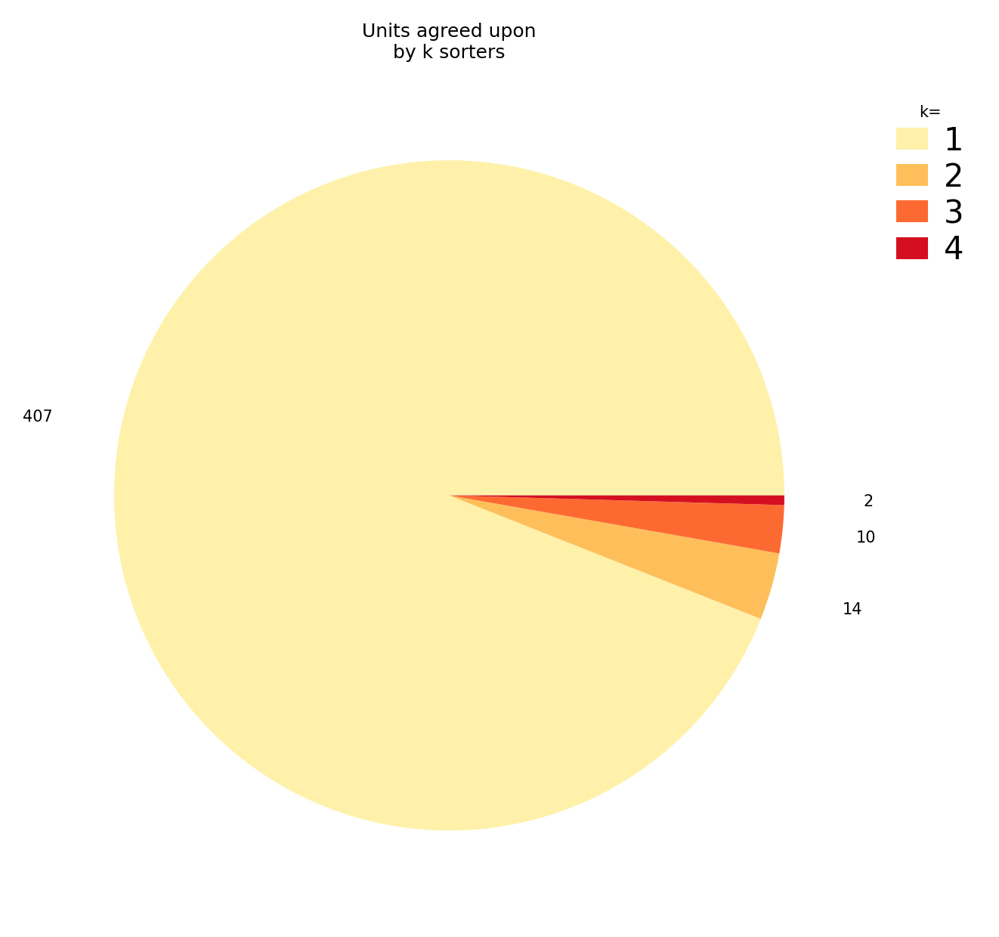

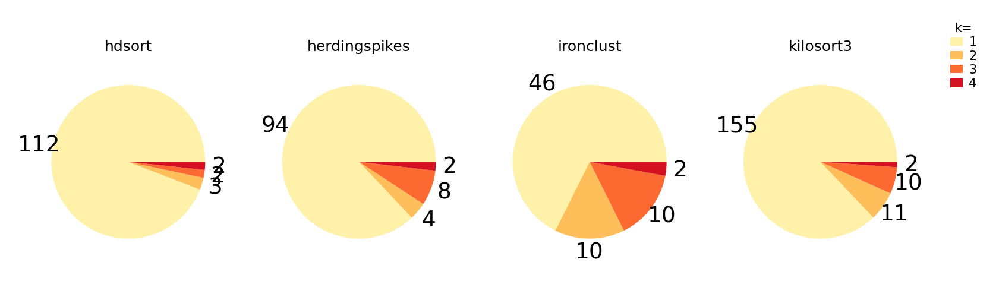

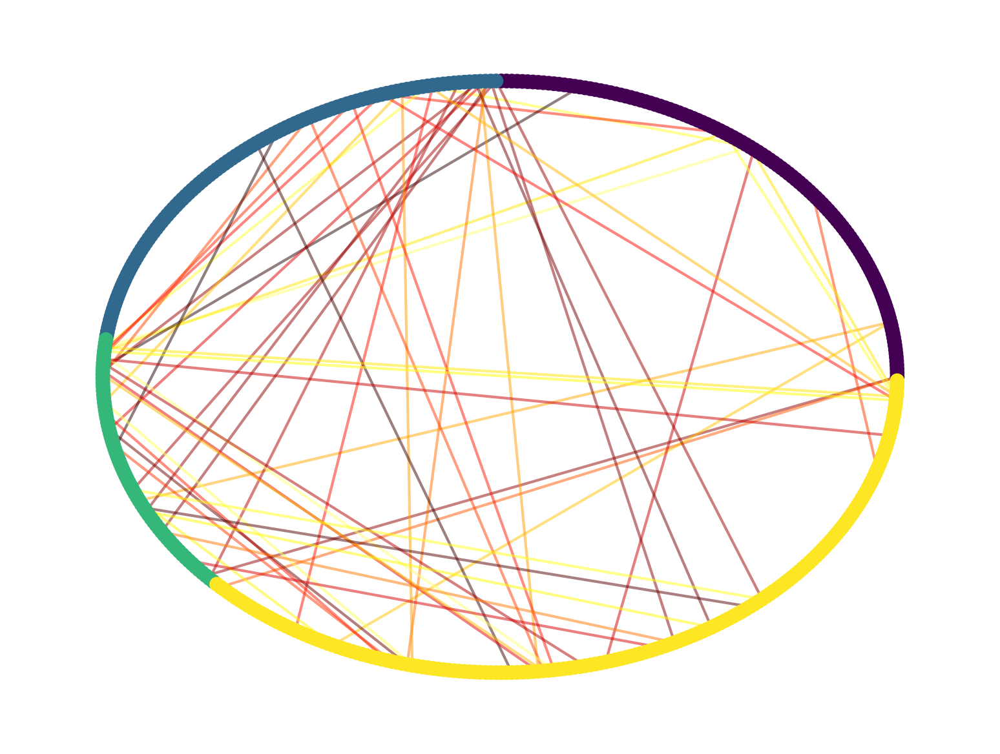

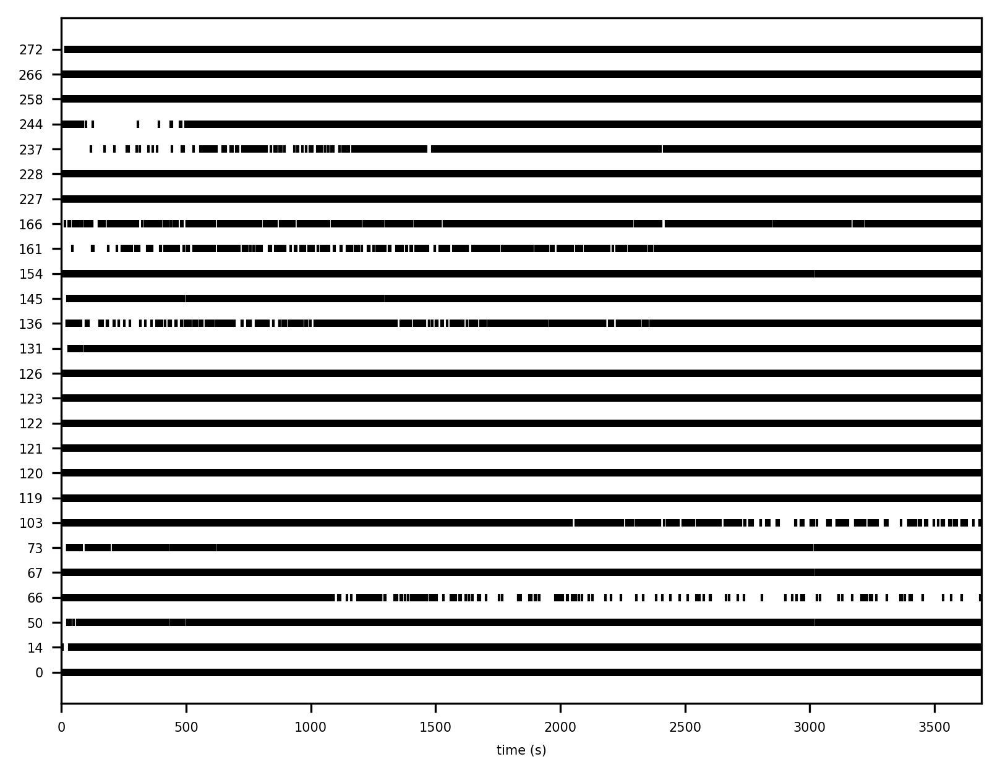

In [42]:
#Compare multiple sorters

mcmp = MultiSortingComparison.load_from_folder(out + '_comparison')
w = sw.plot_multicomp_agreement(mcmp)
w = sw.plot_multicomp_agreement_by_sorter(mcmp)
sw.plot_multicomp_graph(mcmp, draw_labels=False)
agreement_sorting = mcmp.get_agreement_sorting(minimum_agreement_count=2)
print(agreement_sorting)
sw.plot_rasters(agreement_sorting)


In [43]:
print(agreement_sorting)

AgreementSortingExtractor: 26 units - 1 segments - 20.0kHz


In [44]:
we_folder = out + '_consensus' + '_wfs'
we_consensus = si.extract_waveforms(recording, agreement_sorting, we_folder,
                          load_if_exists=False, overwrite=True, verbose = True,
                          ms_before=2, ms_after=2., max_spikes_per_unit=None)
print(we_consensus)

WaveformExtractor: 128 channels - 26 units - 1 segments
  before:40 after:40 n_per_units:None


In [45]:
we = we_consensus
qm = sqm.compute_quality_metrics(we)
qm,rates_per_layer = firingrates_from_sorting(agreement_sorting,we,qm,contact_layers)

In [46]:
rates_per_layer

,firing_rate,count
3,3.227181,2
4,5.417504,8
5,8.371631,12
6,10.185181,4


In [47]:
qm

,num_spikes,firing_rate,presence_ratio,snr,isi_violations_ratio,isi_violations_rate,isi_violations_count,amplitude_cutoff,layer
0,37013,10.034245,1.00,7.617570,0.097829,0.029550,109,0.000200,6
14,44368,12.028190,1.00,9.167499,0.113679,0.049340,182,0.000006,5
50,5718,1.550153,1.00,6.977830,0.300850,0.002169,8,0.000045,5
66,6221,1.686517,0.88,33.364483,0.413020,0.003524,13,0.000042,4
67,19105,5.179376,1.00,22.902538,0.245911,0.019790,73,0.000083,3
73,4703,1.274986,1.00,25.163034,0.277951,0.001356,5,0.000055,3
103,23239,6.300106,0.98,5.153411,3.717916,0.442707,1633,0.000011,4
119,85128,23.078249,1.00,12.472761,0.085174,0.136092,502,0.000003,5
120,69046,18.718410,1.00,13.113768,0.719316,0.756099,2789,0.000070,5
121,51086,13.849444,1.00,15.701836,0.021201,0.012200,45,0.000034,5


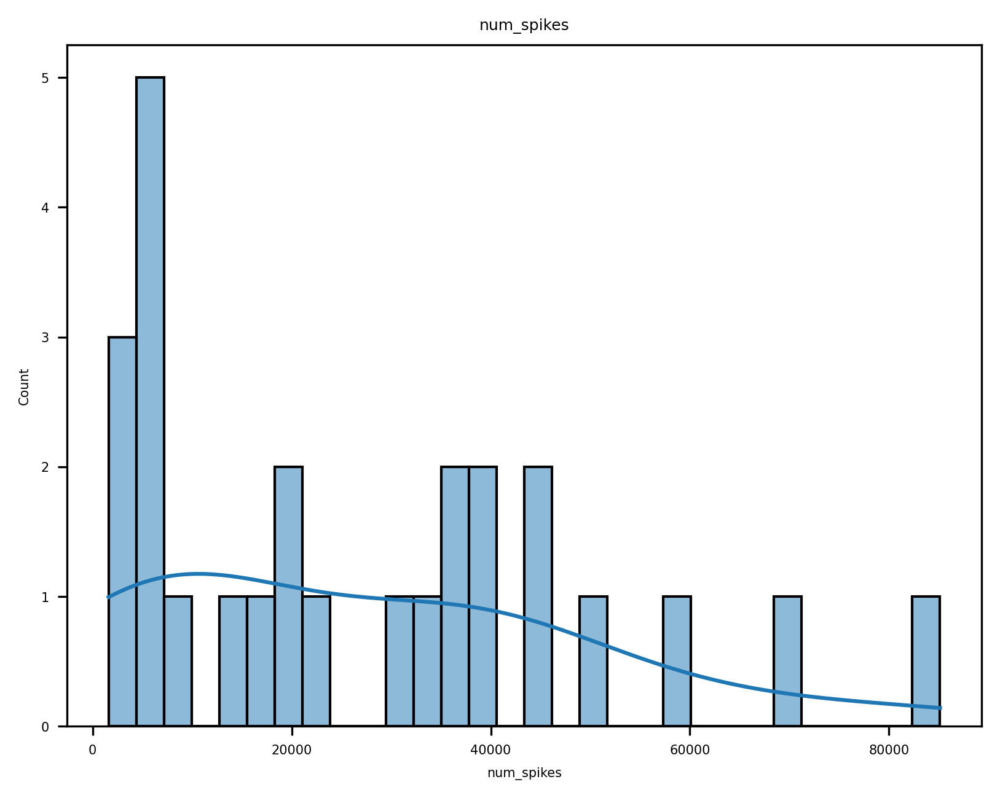

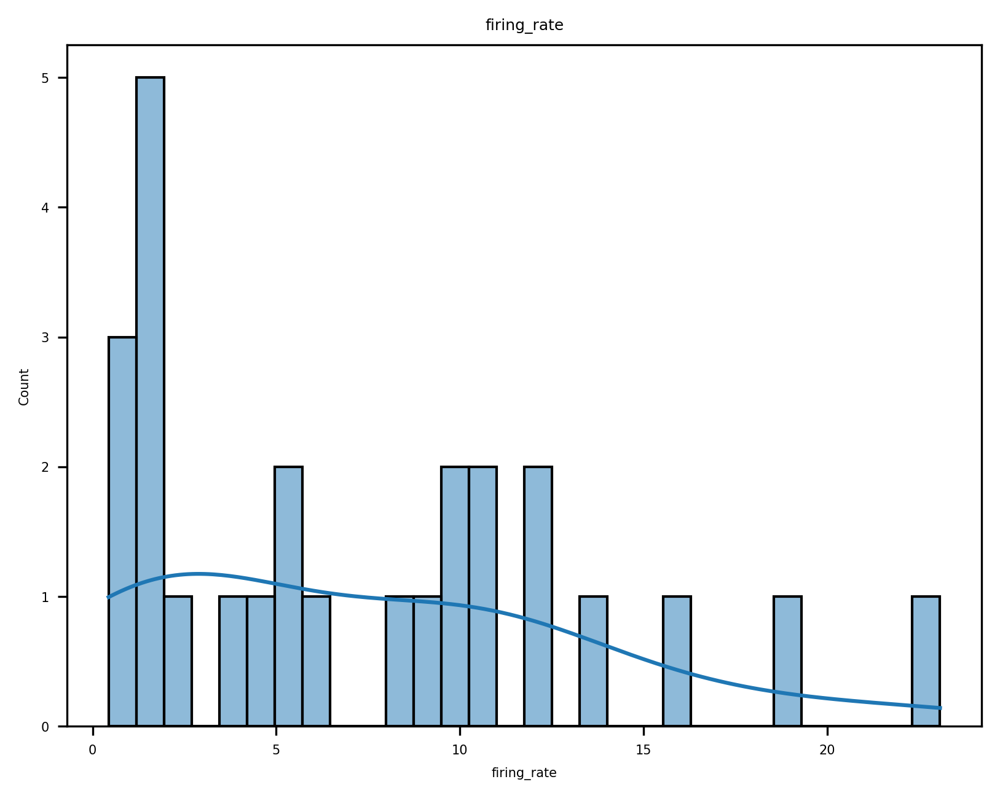

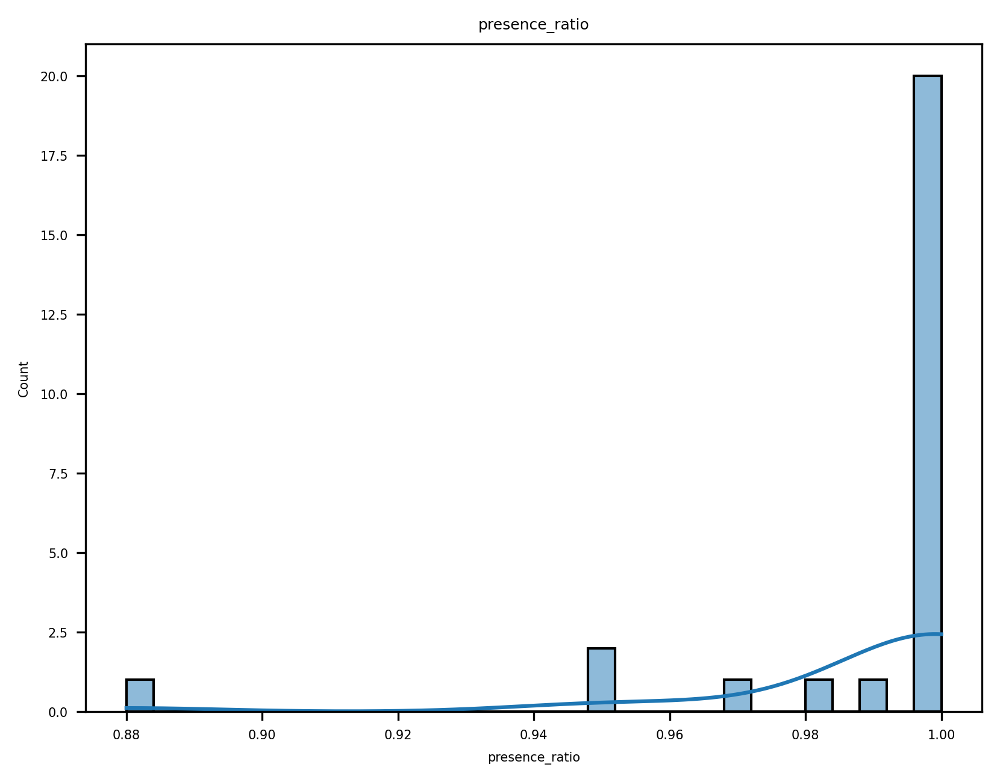

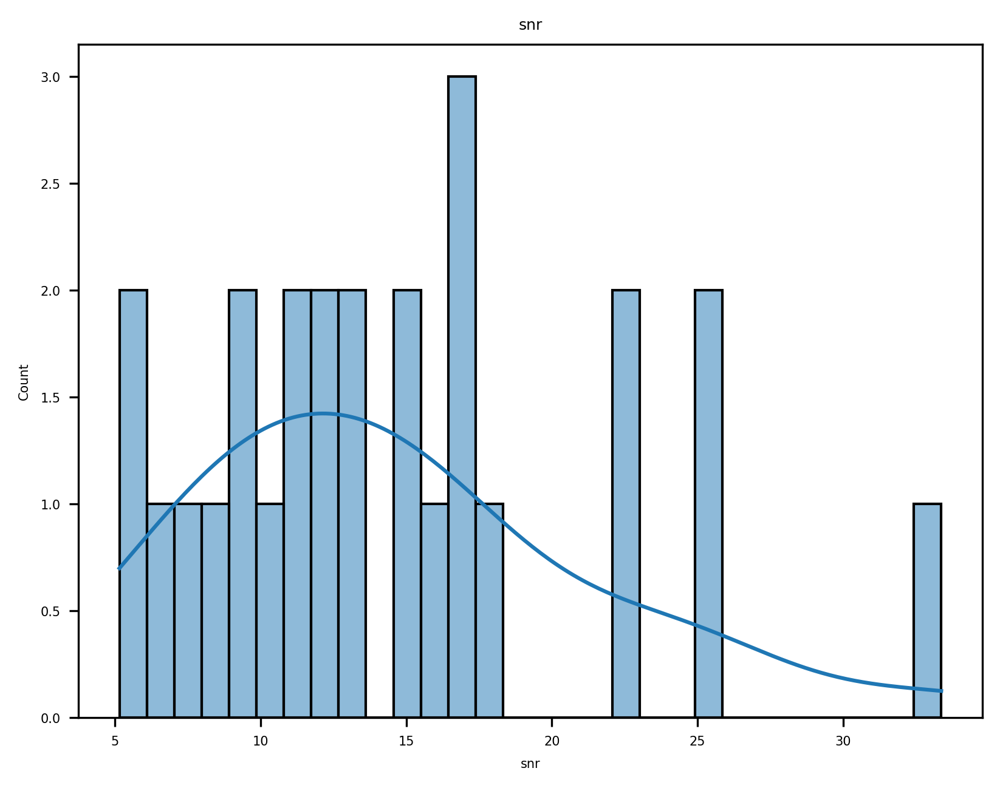

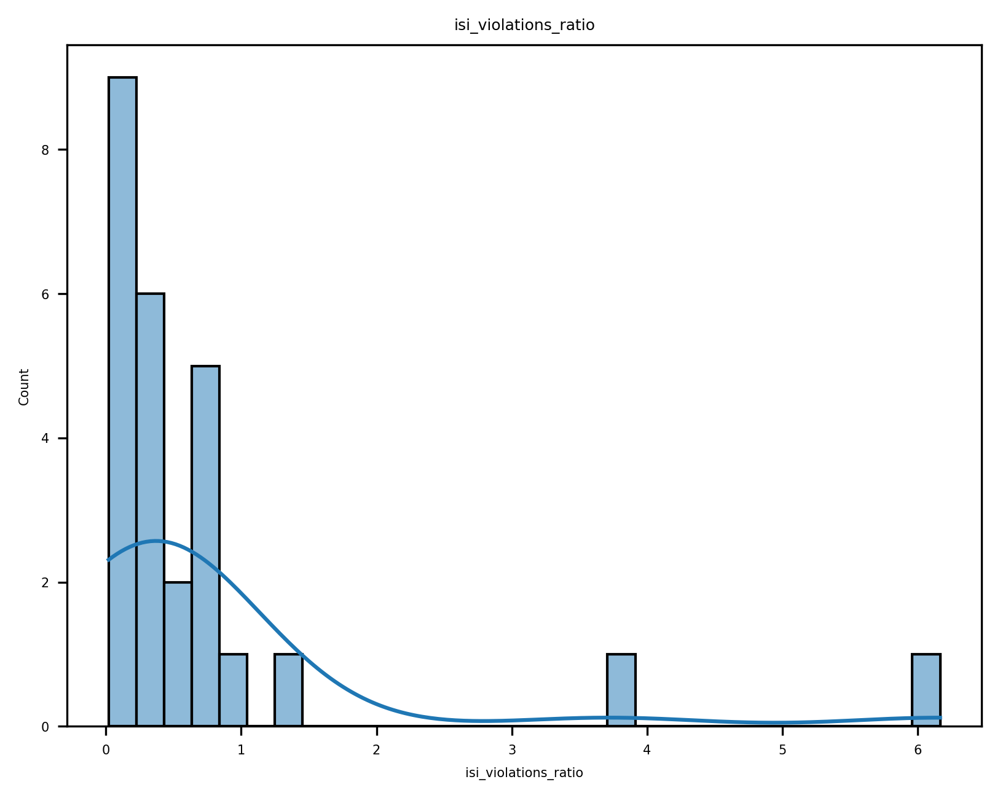

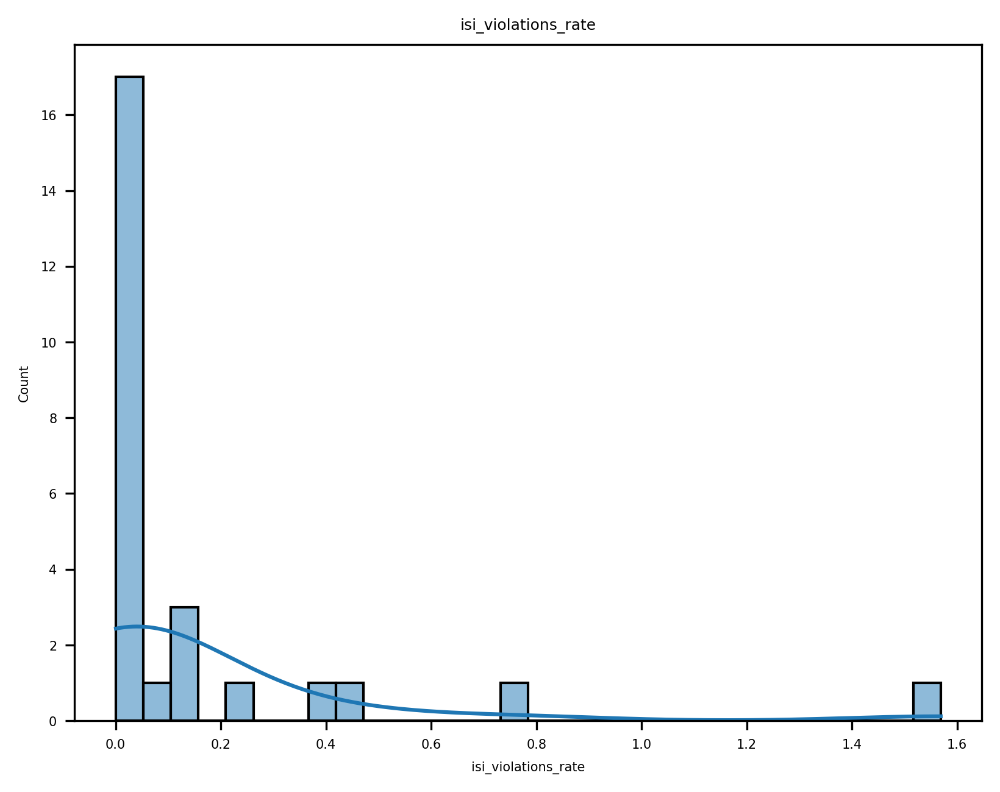

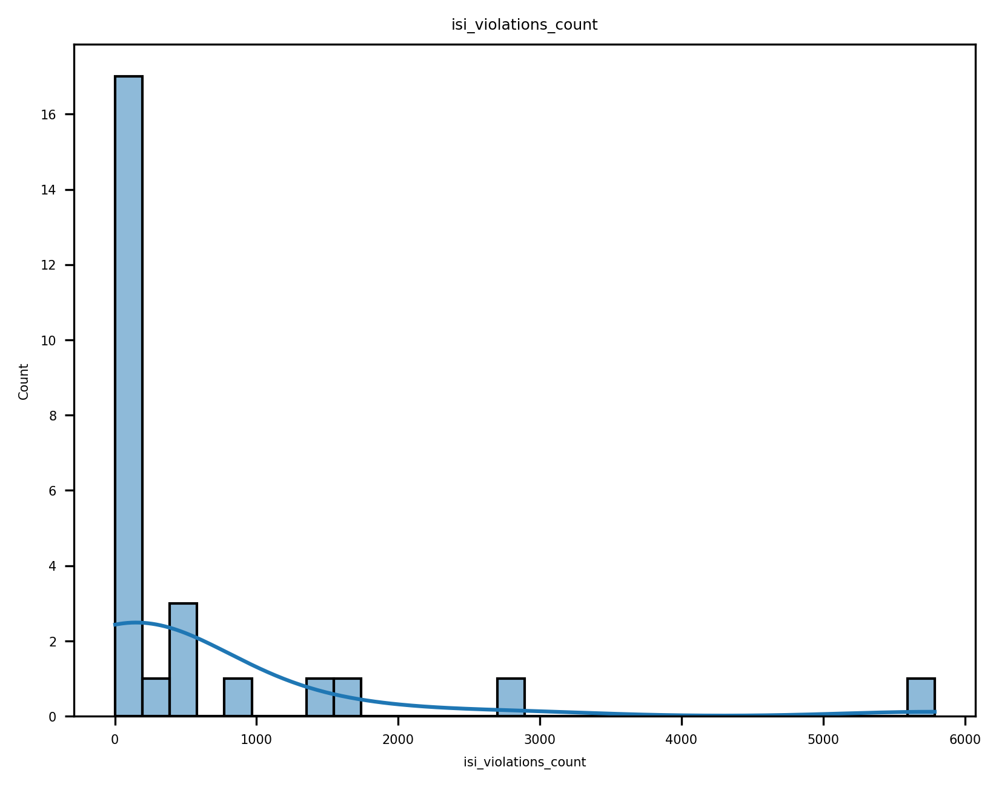

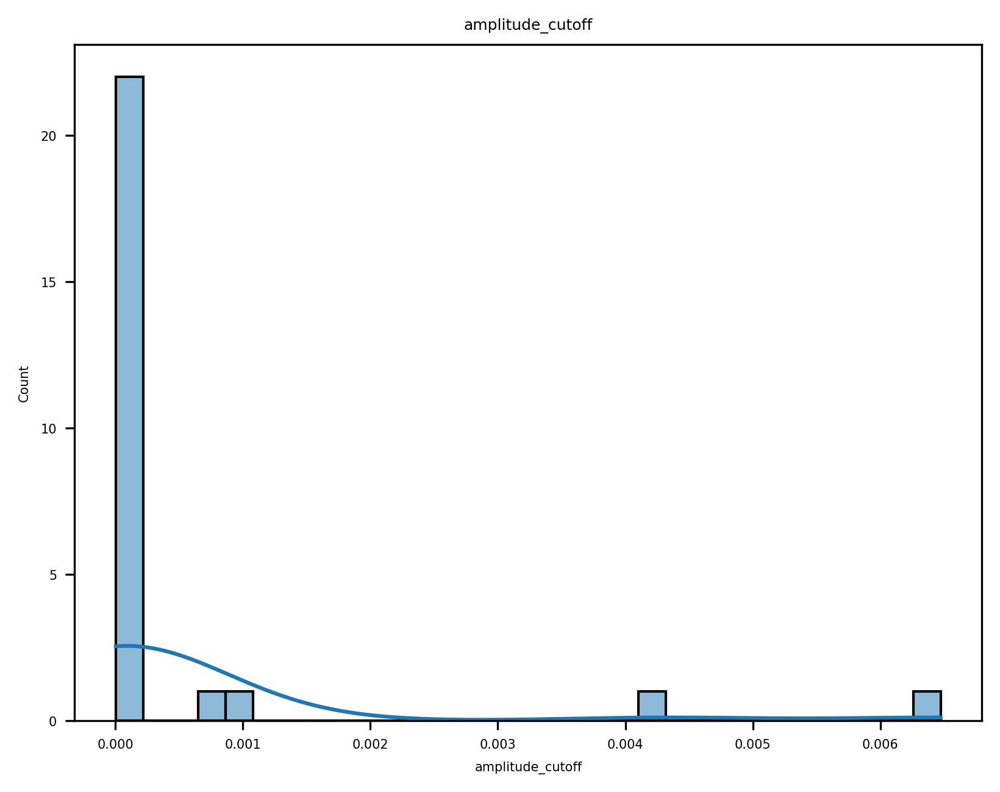

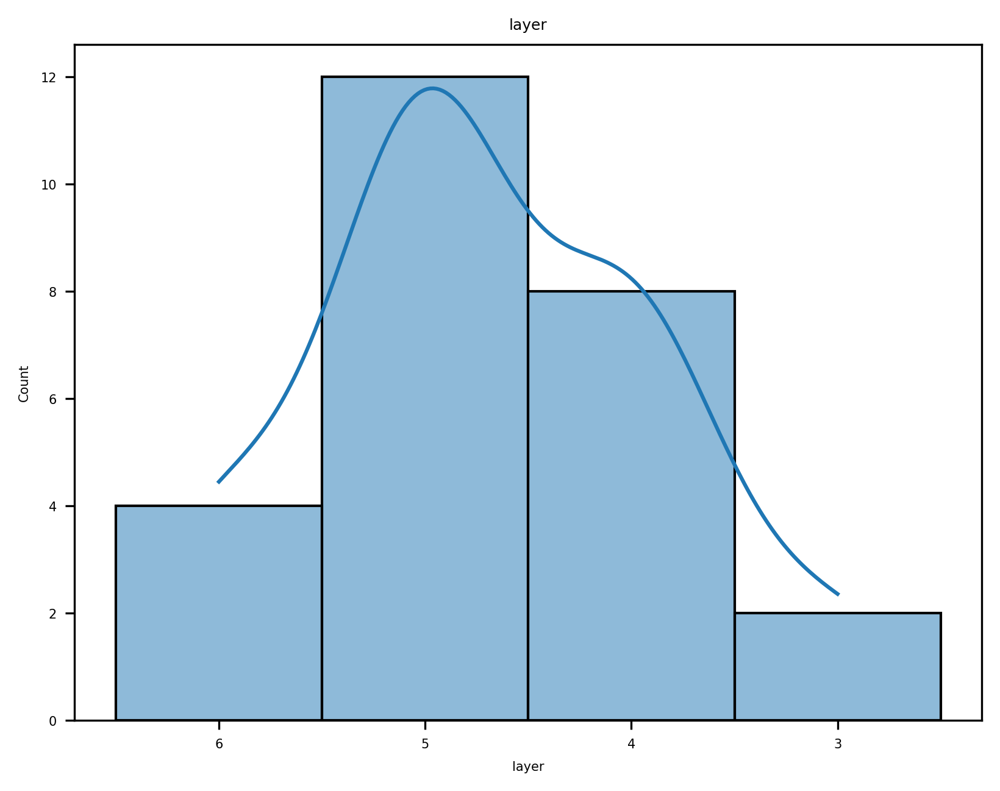

In [48]:
for col in qm.columns:
    sns.histplot(qm[col], bins = 30, kde = True)
    plt.title(col)
    plt.show()

125


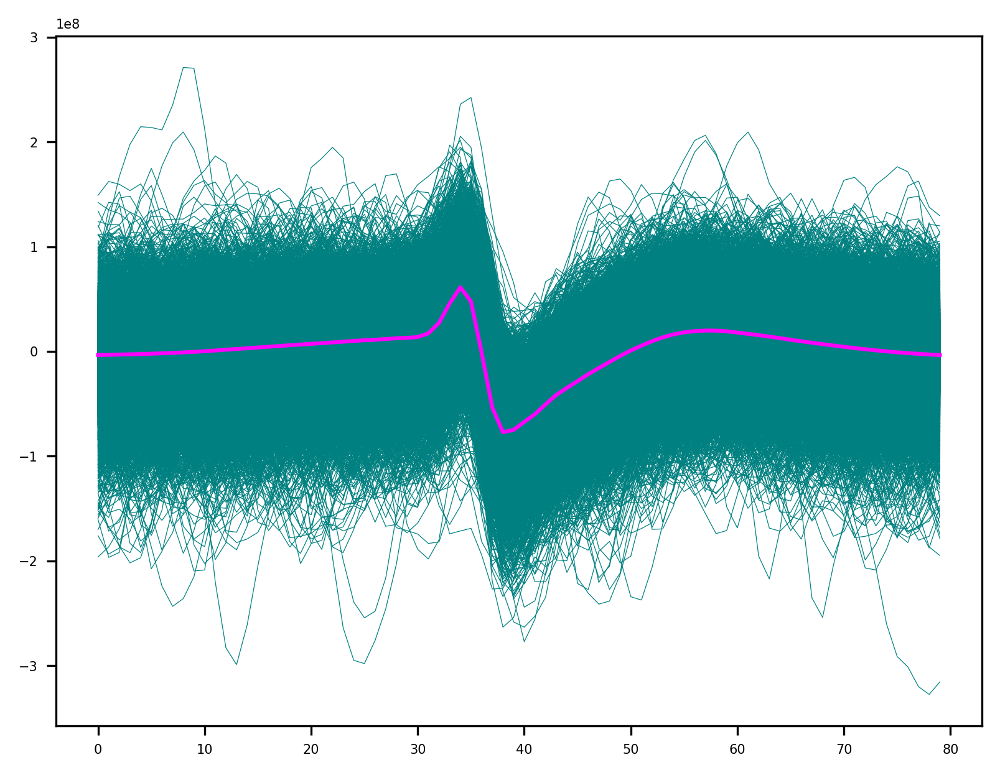

101


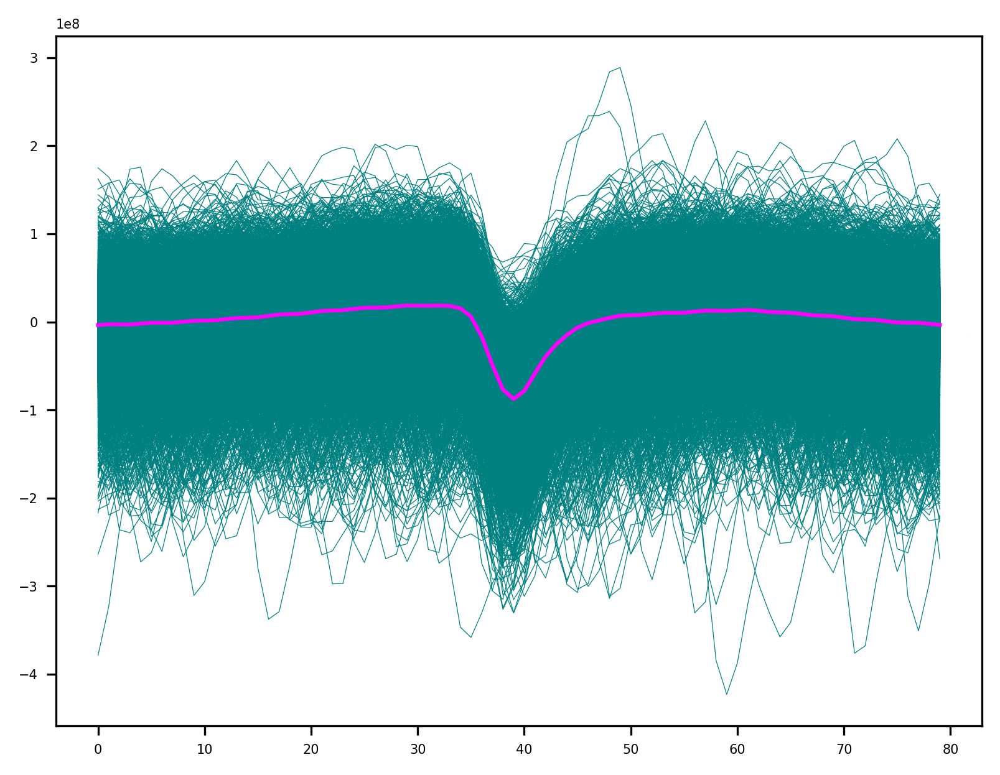

31


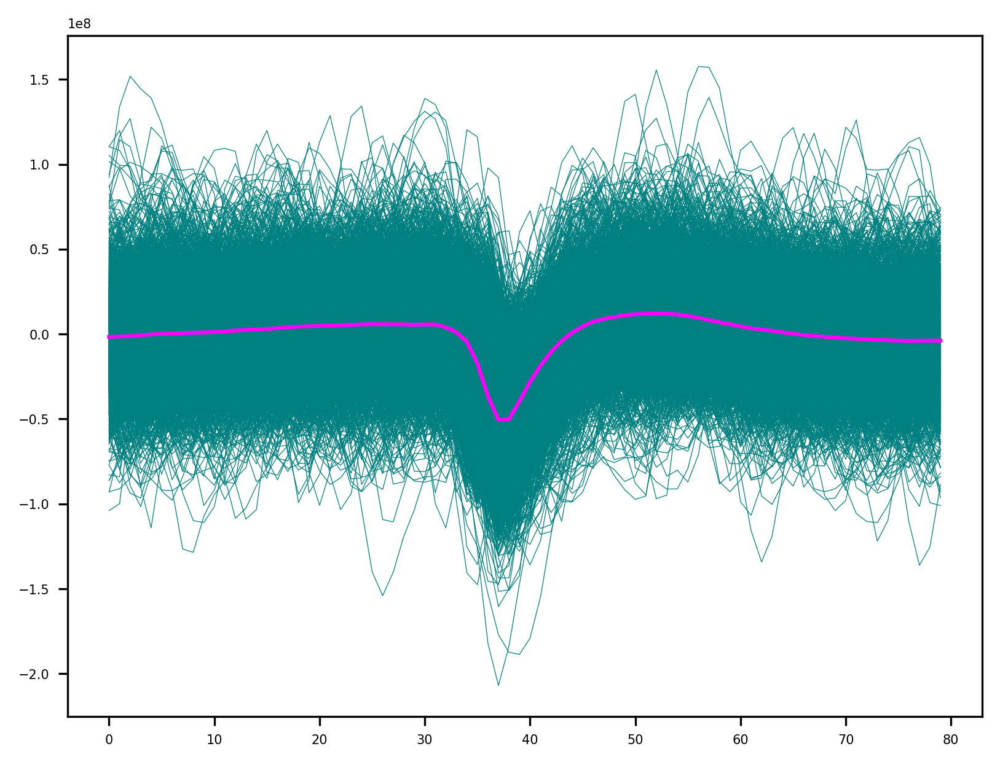

17


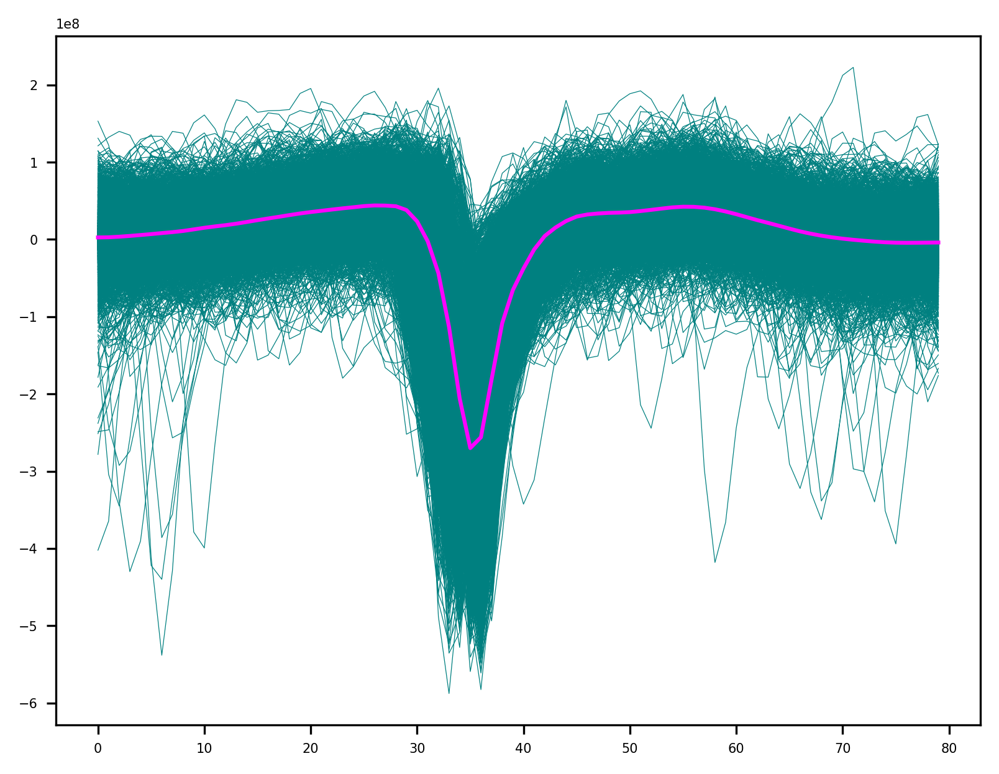

8


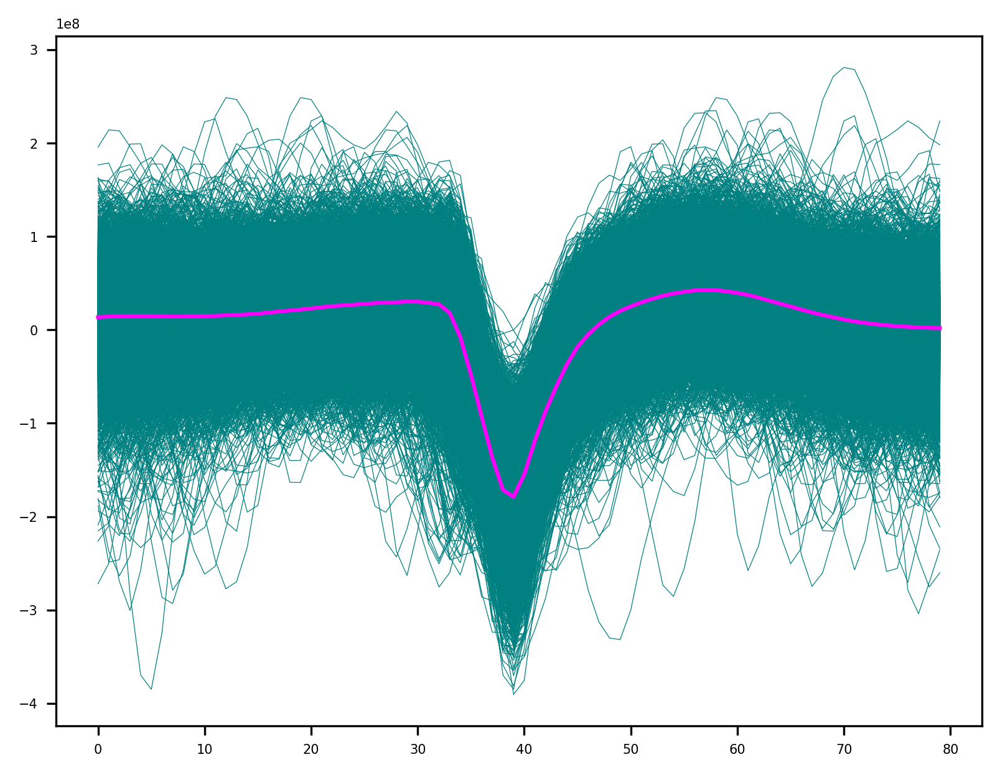

3


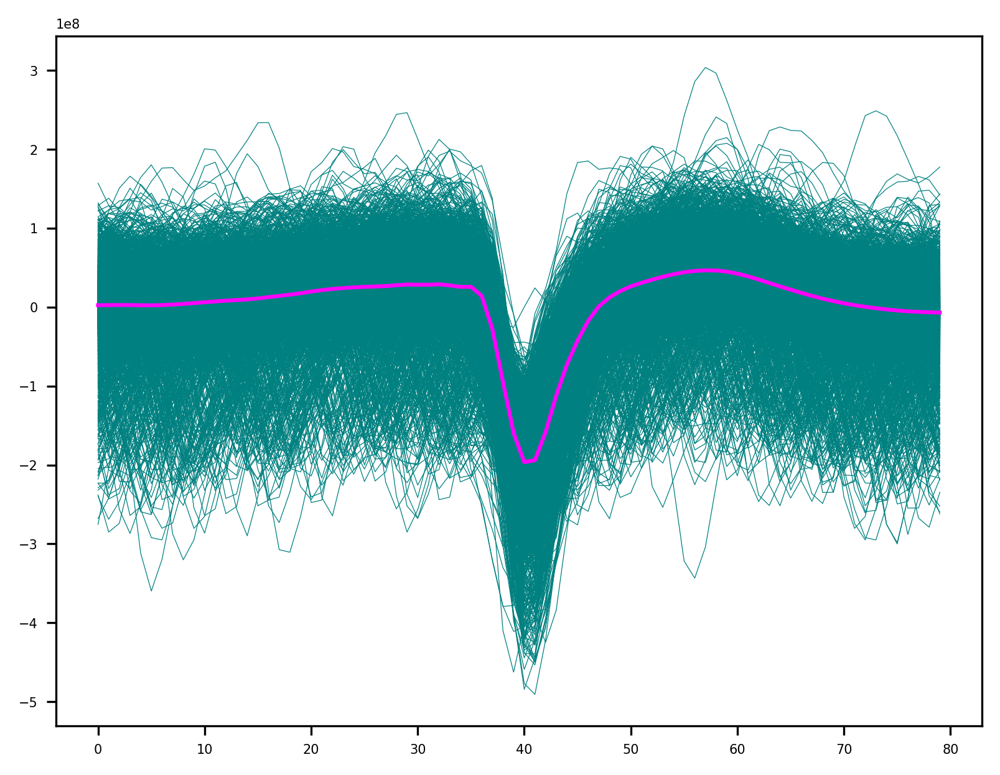

16


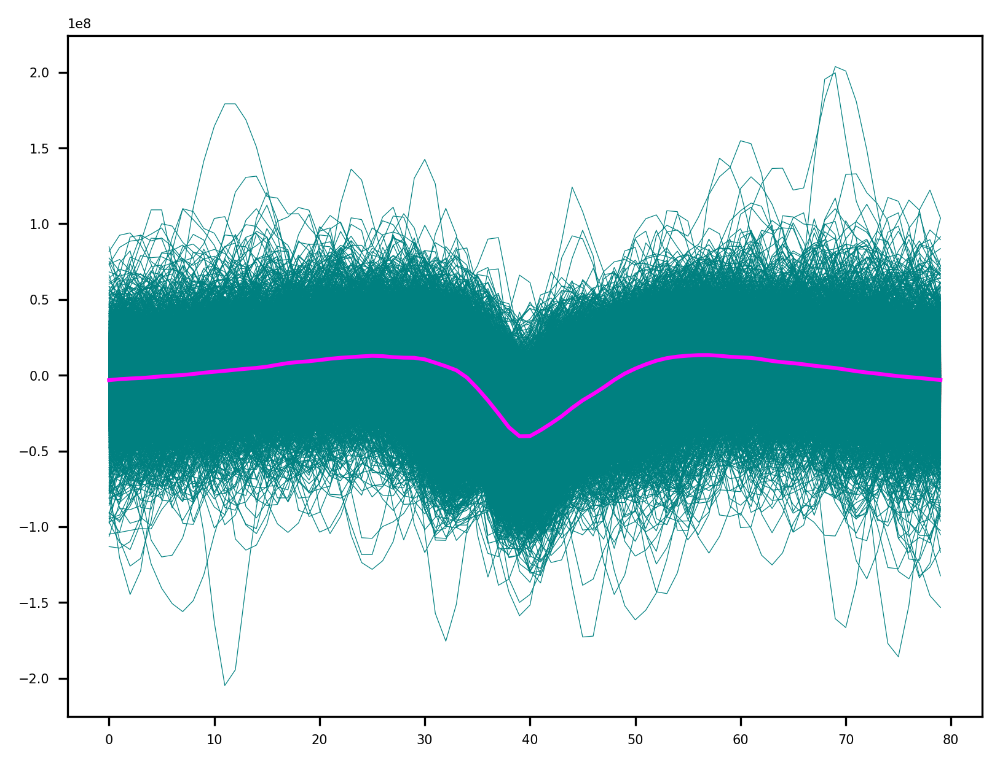

96


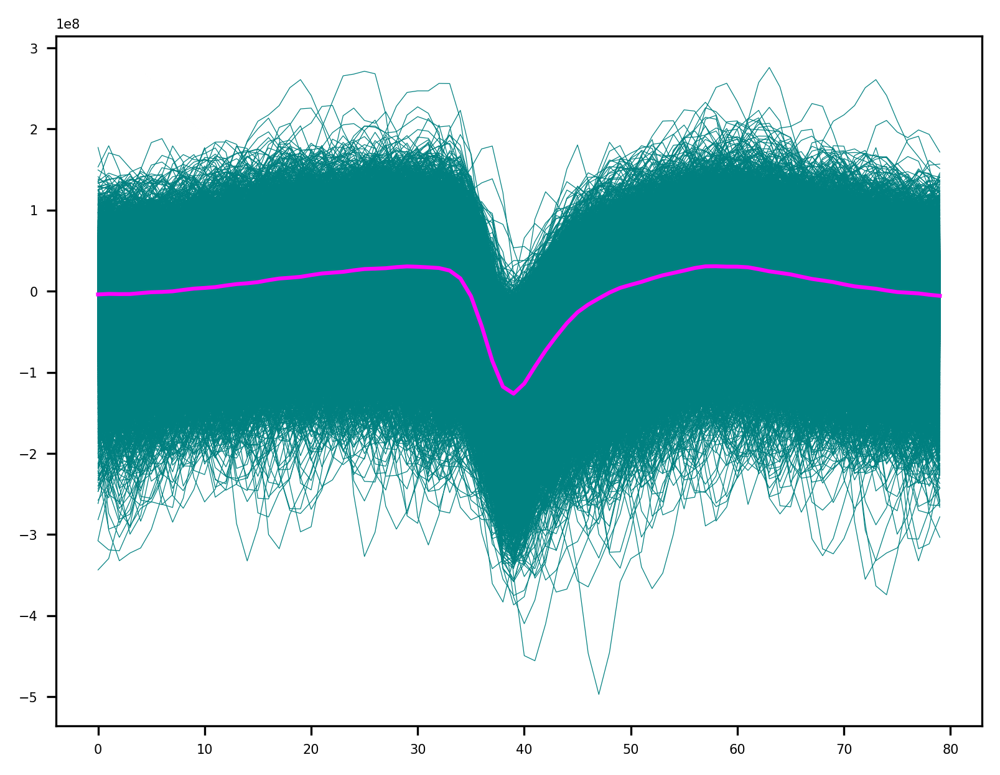

116


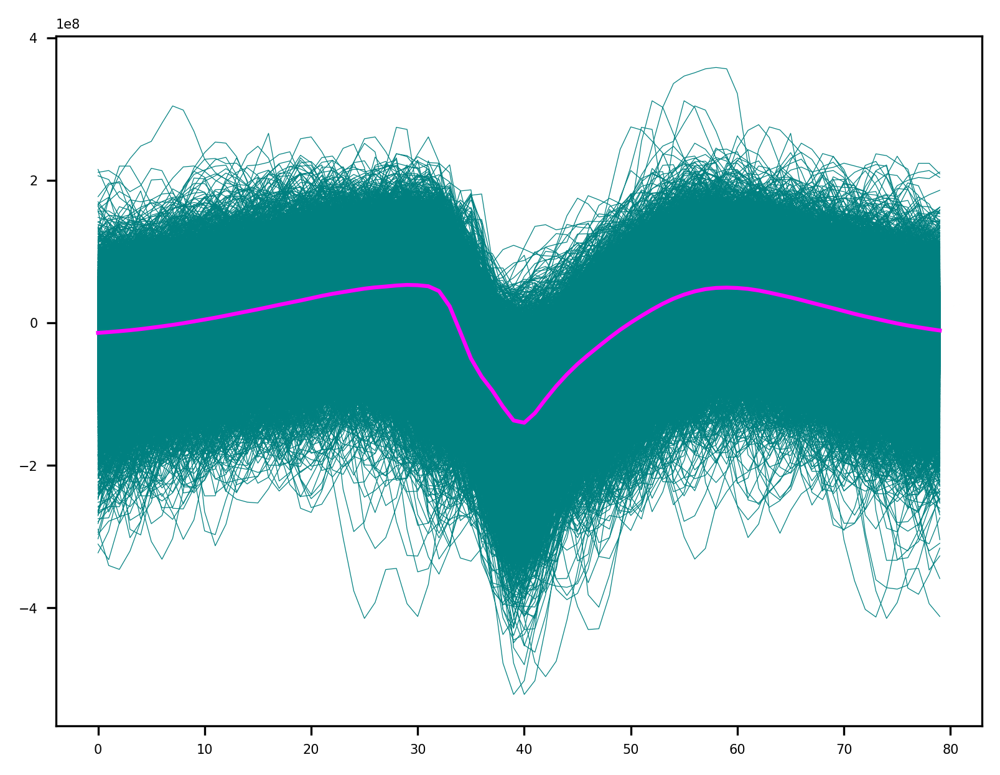

70


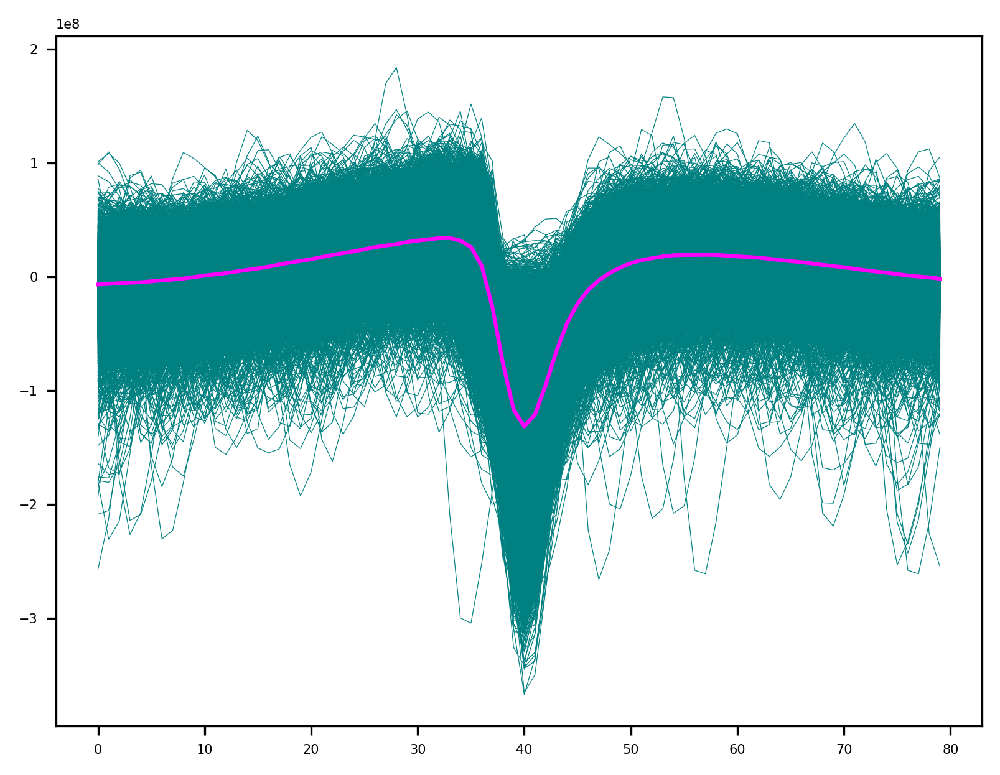

17


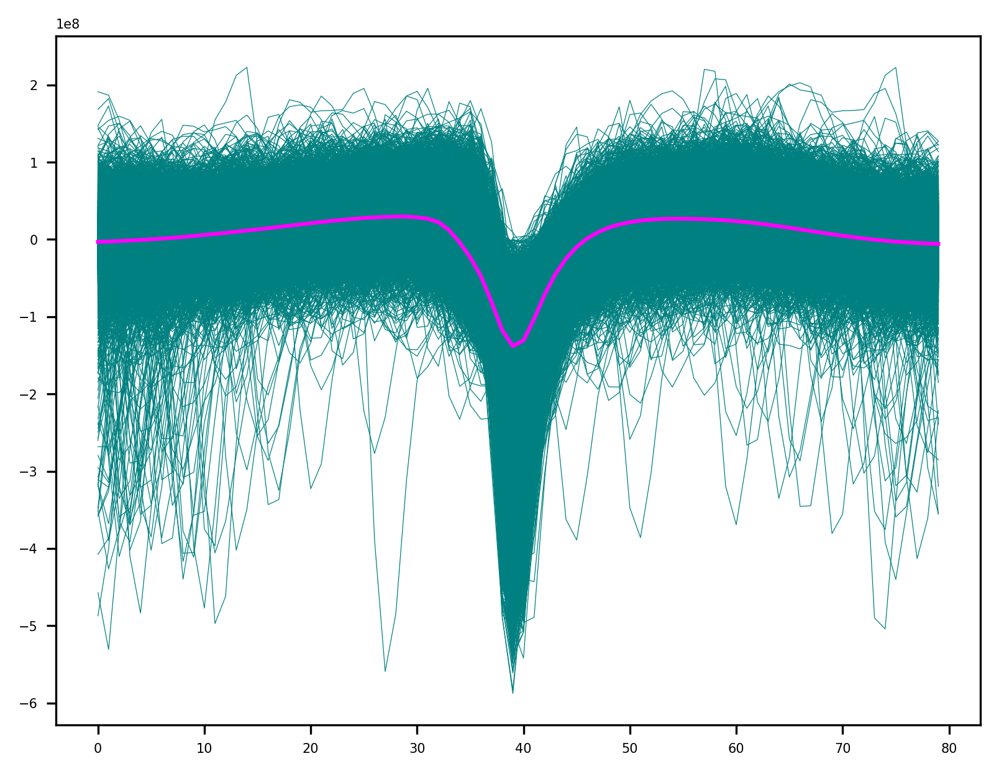

104


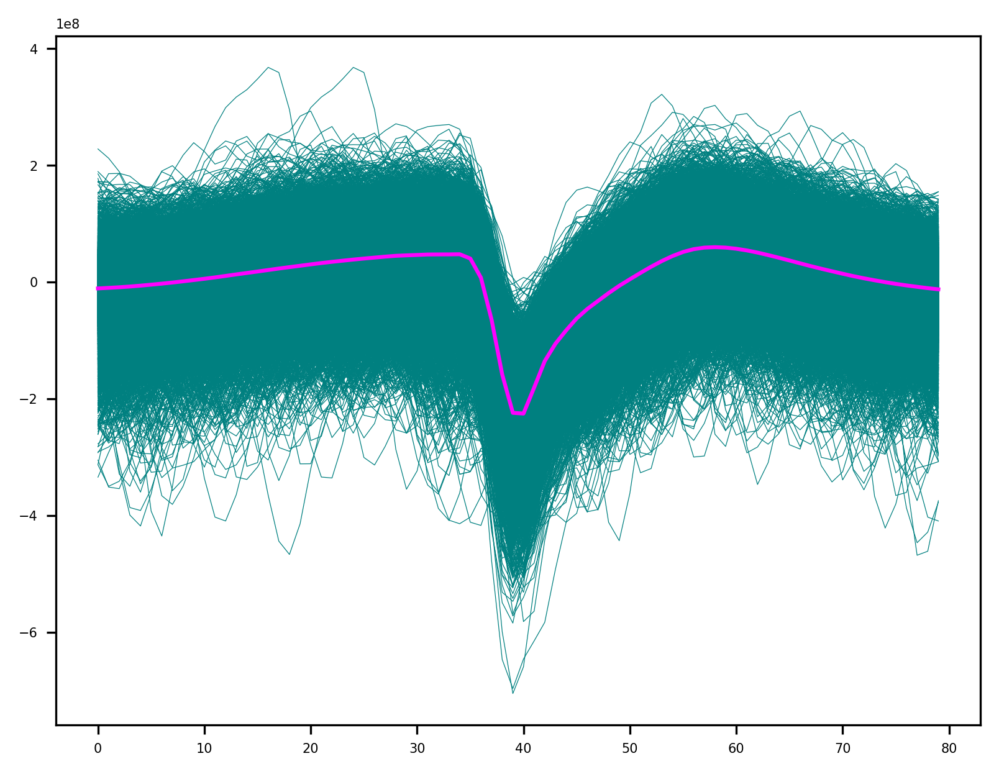

128


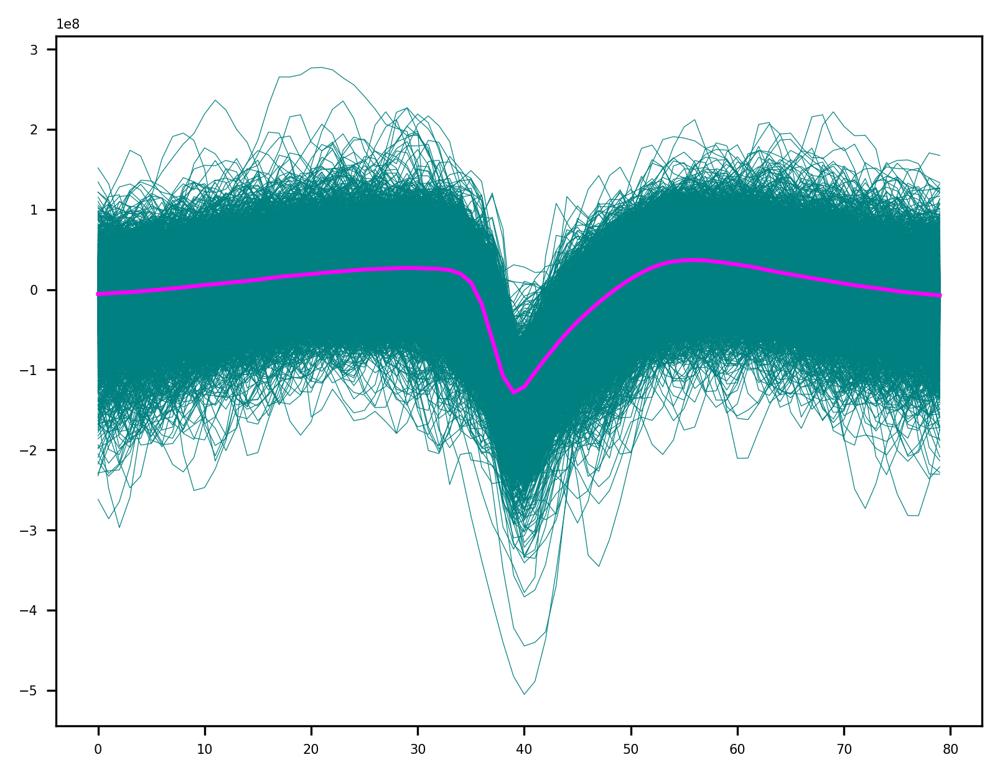

105


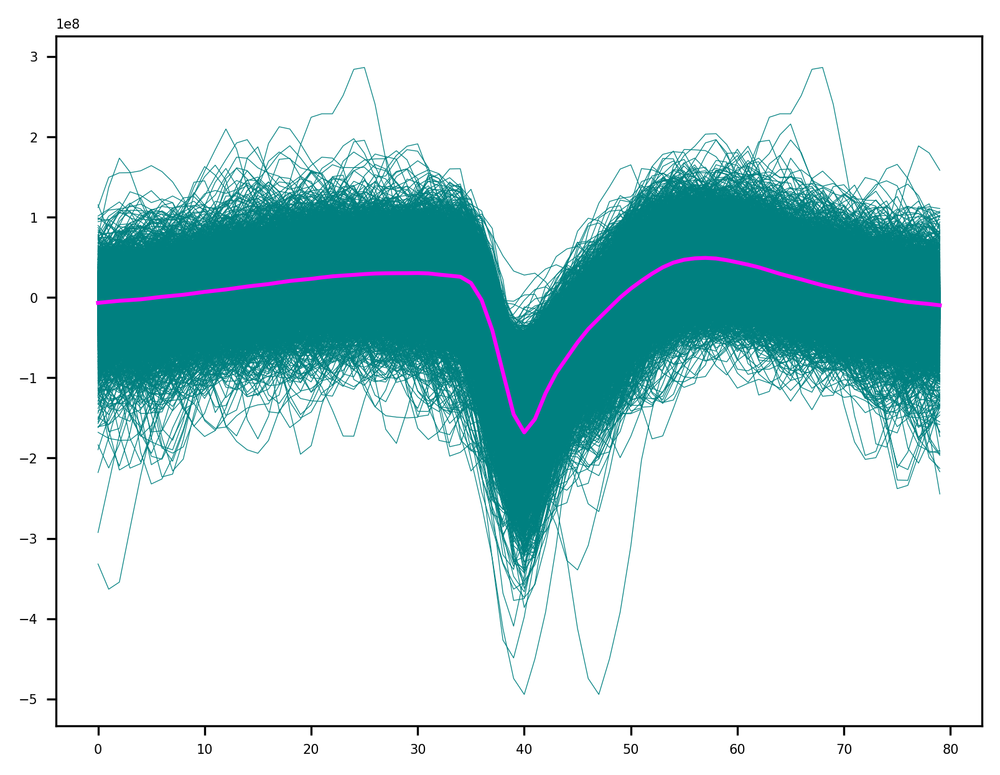

66


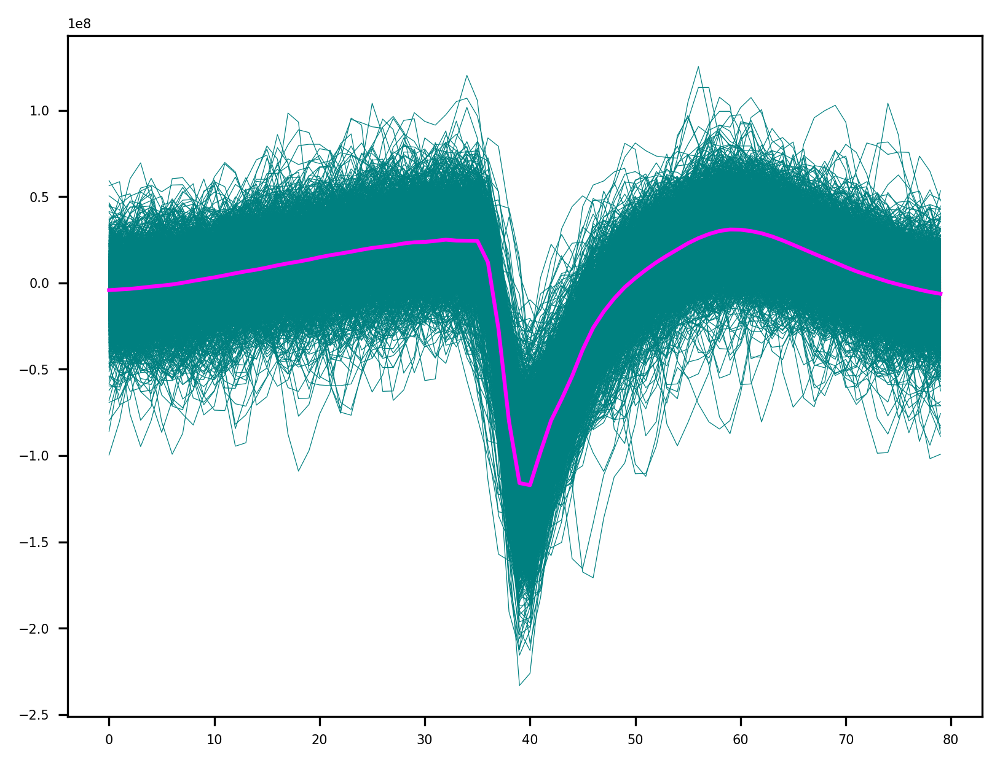

9


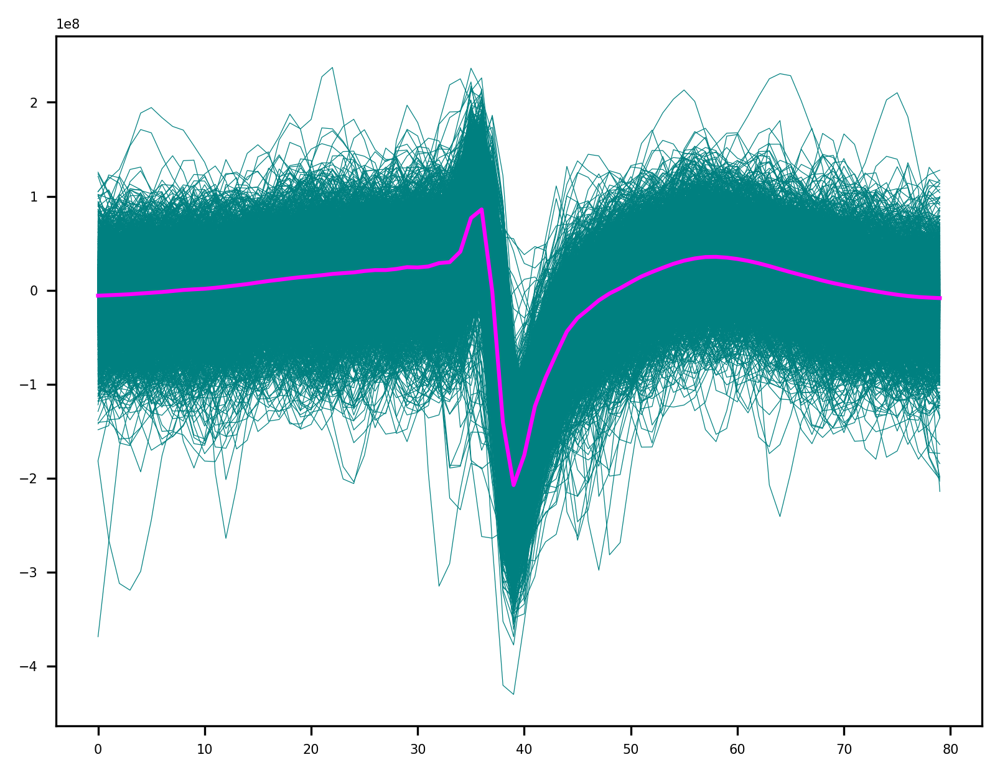

18


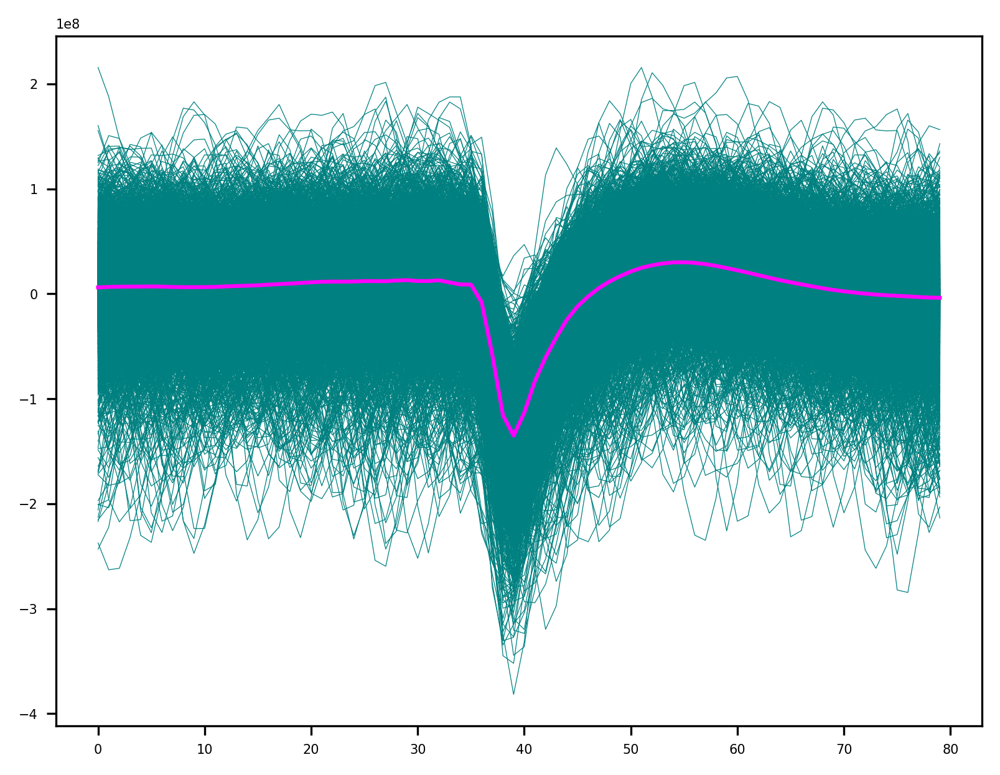

75


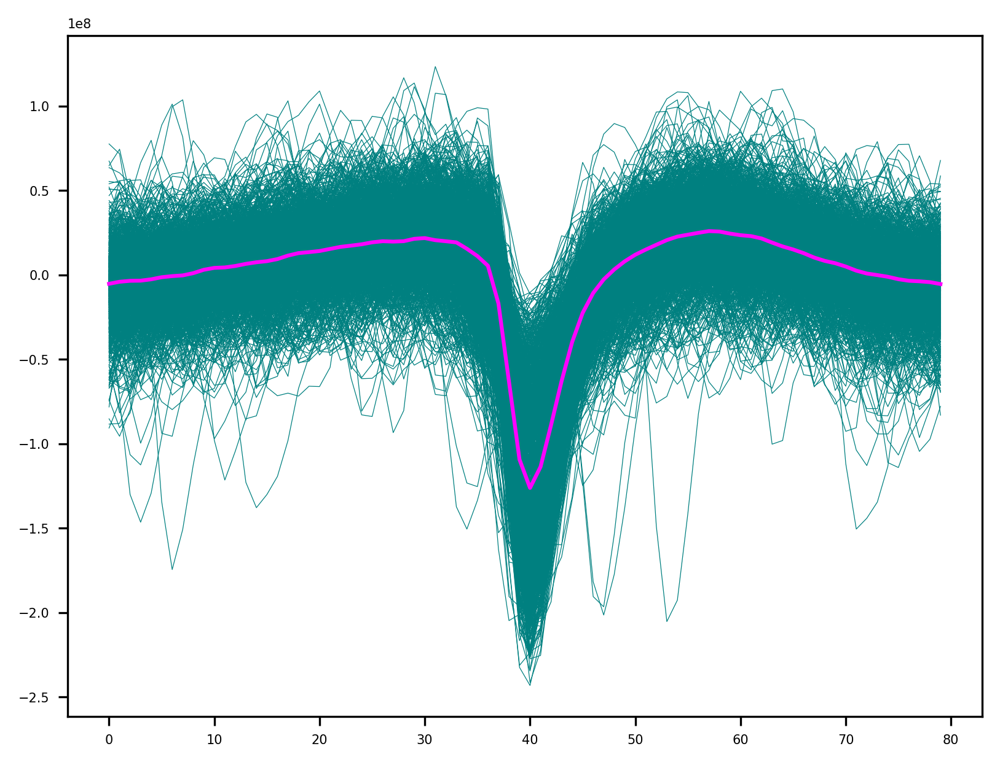

26


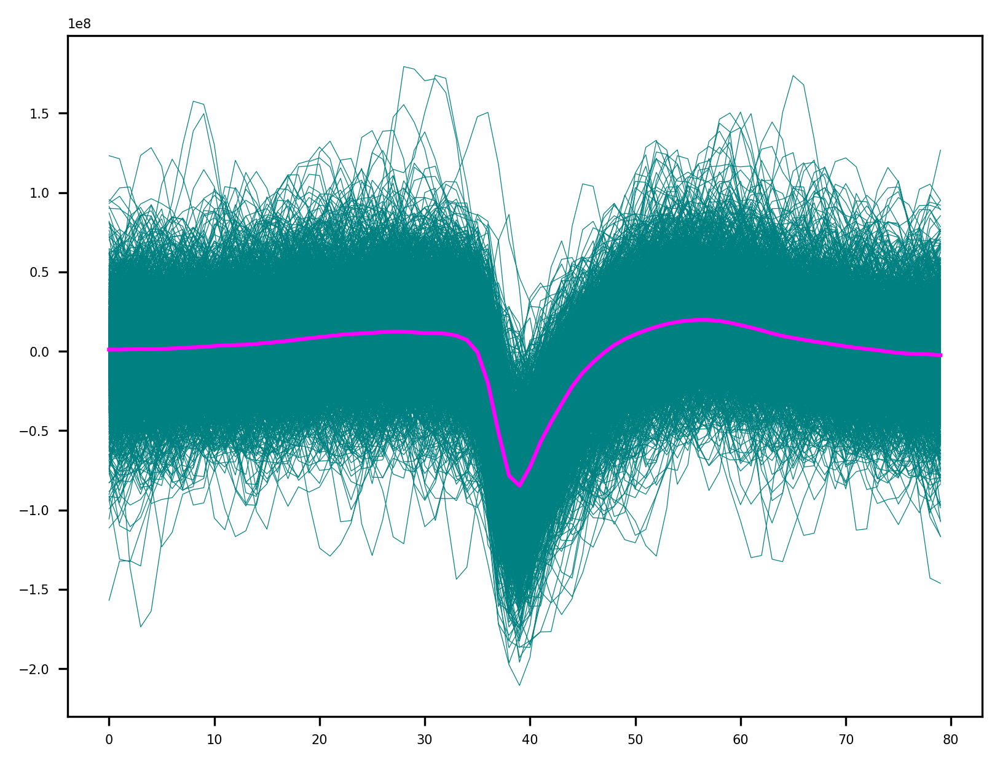

12


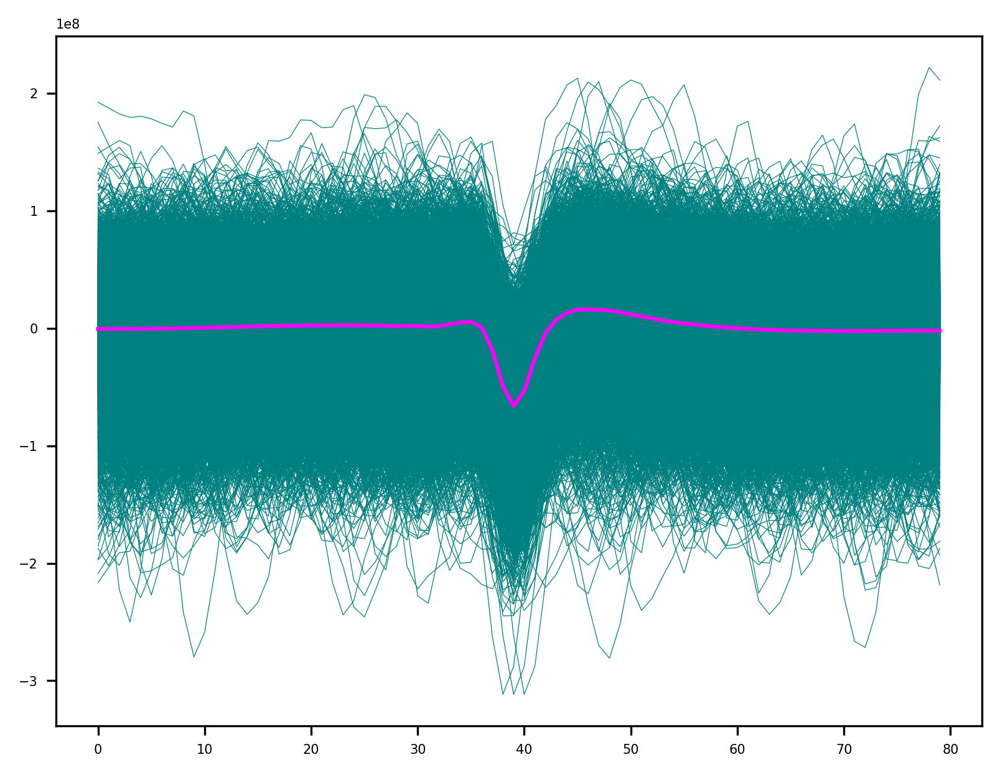

13


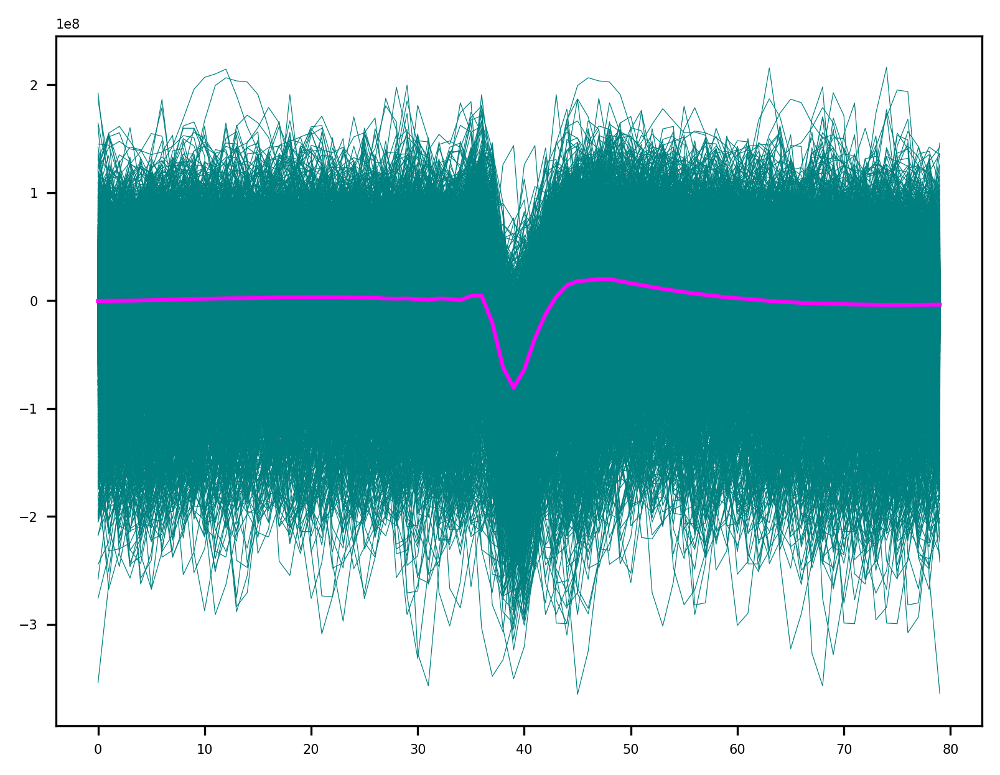

69


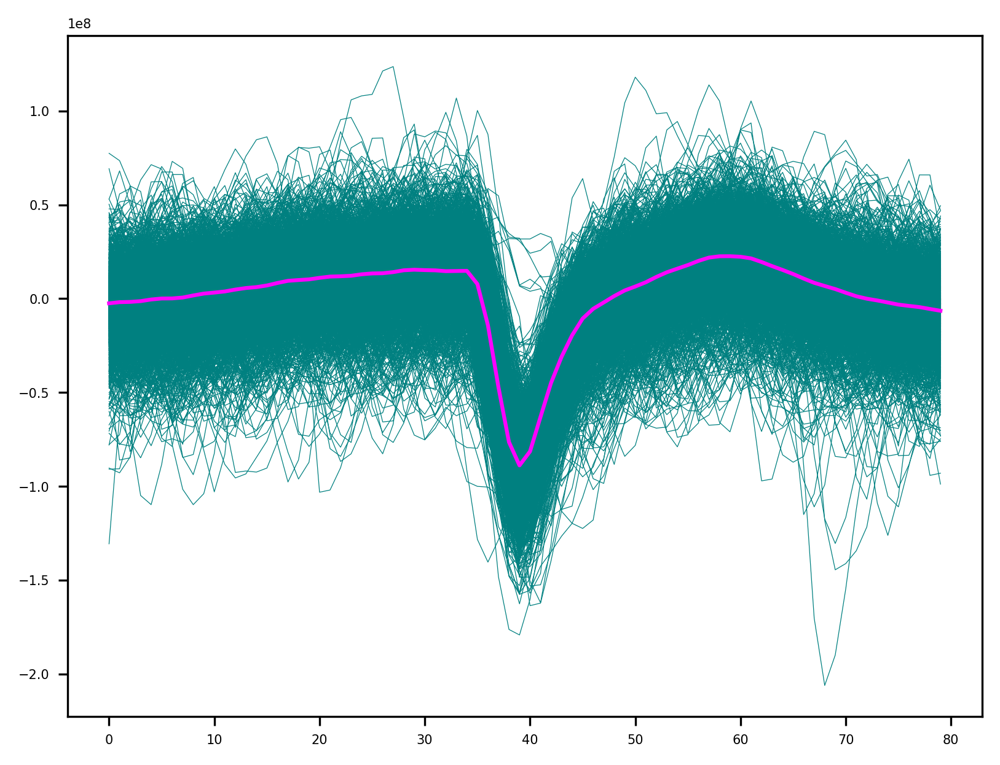

73


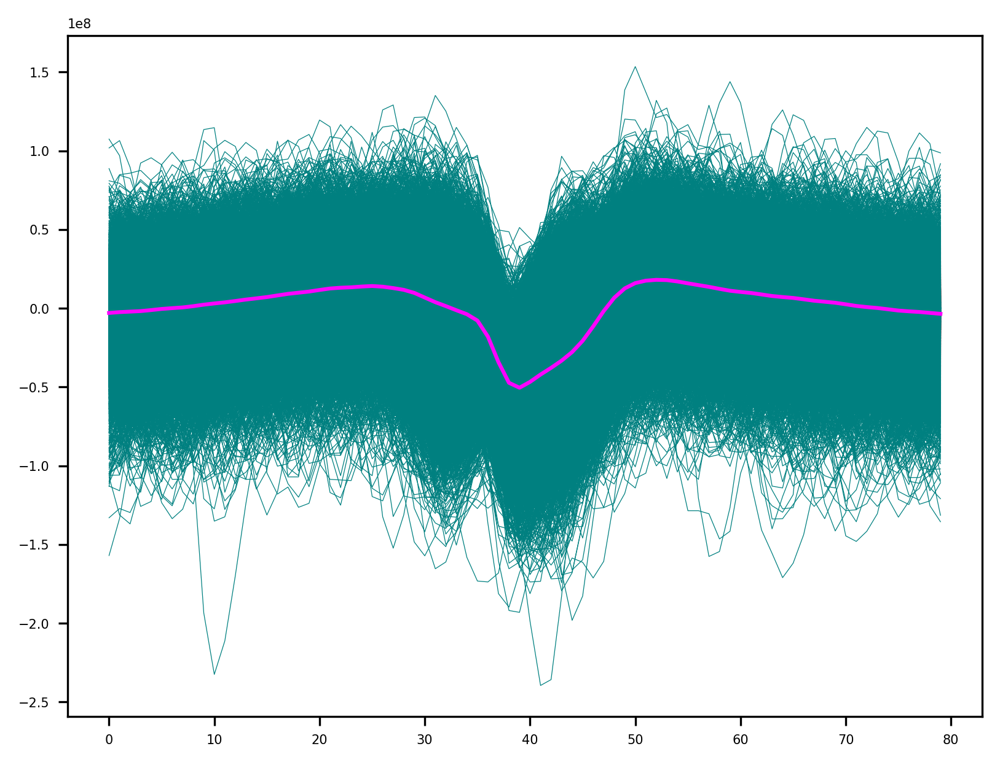

104


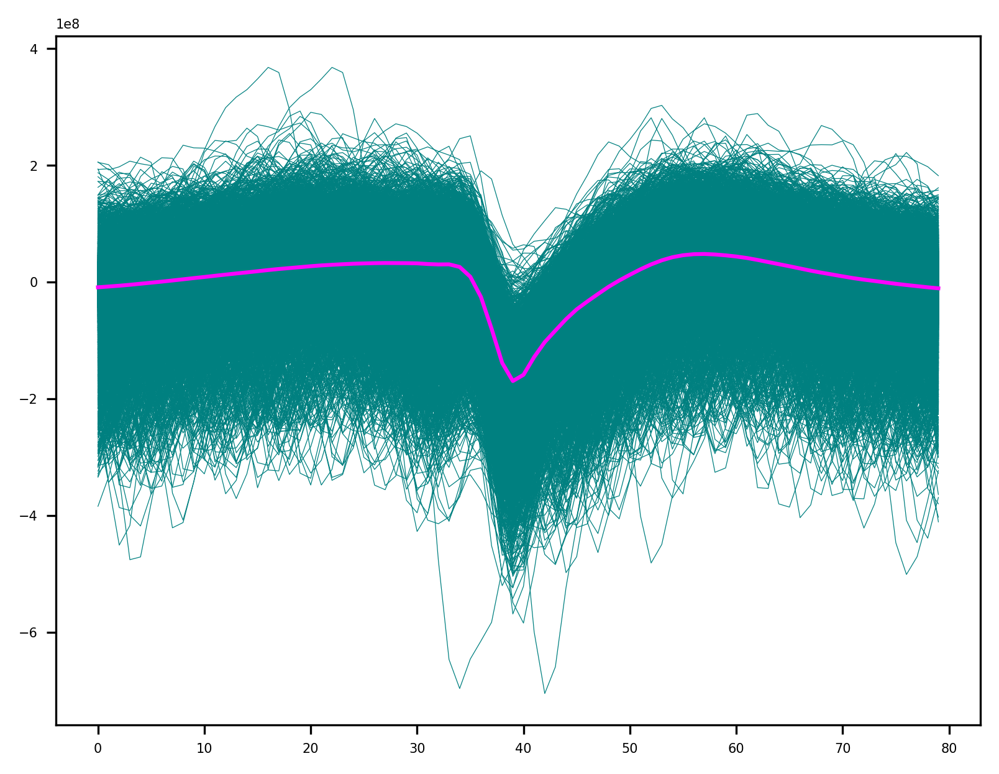

117


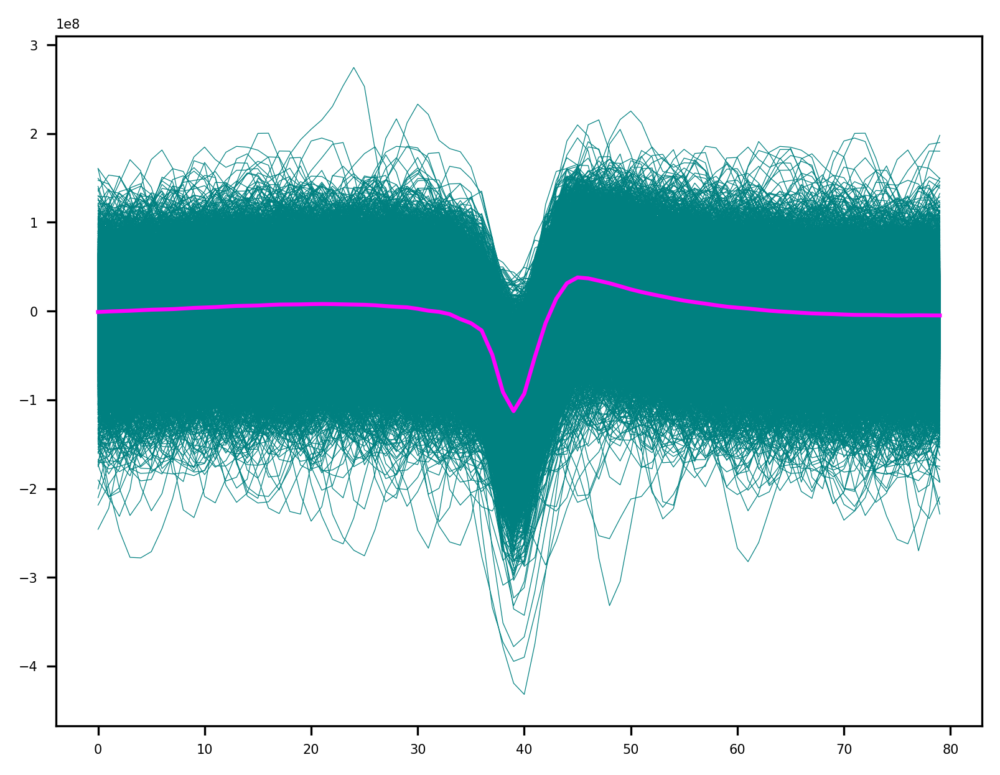

124


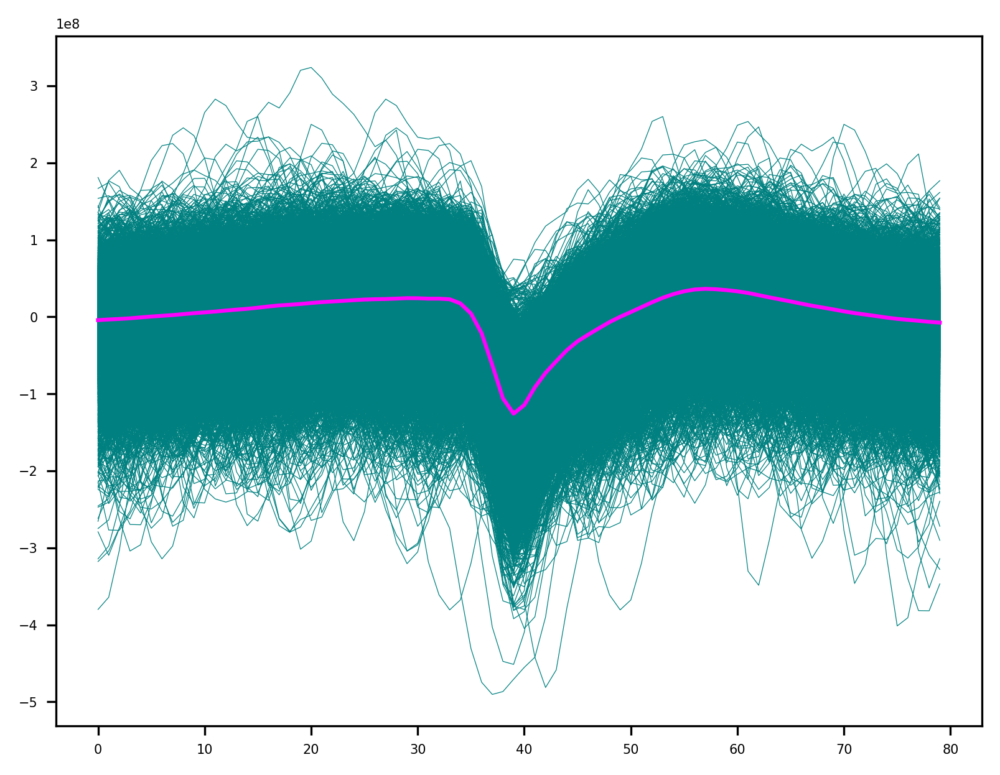

In [49]:
colors = ['Olive', 'Teal', 'Fuchsia']
max_chids = spost.get_template_extremum_channel(we, peak_sign='neg')
for i, unit_id in enumerate(agreement_sorting.unit_ids):
    wf = we.get_waveforms(unit_id)
    color = colors[1]
    
    idx = int(max_chids[unit_id])
    print(idx)
    plt.plot(wf[:, :, idx-1].T, color=color, lw=0.3)
    tmp = we.get_template(unit_id)
    plt.plot(tmp[:,idx-1], color = colors[2])
    plt.show()

# Other code

In [ ]:
w_ts1 = sw.plot_timeseries(recording, time_range=(54,55), mode = 'map')
w_ts1 = sw.plot_timeseries(recording,channel_ids=channel_ids[-4:], time_range=(54.12,54.14))
w_ts1 = sw.plot_timeseries(rec,channel_ids=channel_ids[-4:], time_range=(54.12,54.14))

In [ ]:
nwbrec = se.NwbRecordingExtractor(datapath + filename)

In [ ]:
we = WaveformExtractor.load_from_folder(we_folder)
max_chids = spost.get_template_extremum_channel(we, peak_sign='neg')
max_chids
sorting.get_unit_spike_train(0)

In [ ]:
colors = ['Olive', 'Teal', 'Fuchsia']
max_chids = spost.get_template_extremum_channel(we, peak_sign='neg')
for i, unit_id in enumerate(sorting.unit_ids):
    wf = we.get_waveforms(unit_id)
    color = colors[1]
    
    idx = int(max_chids[unit_id])
    print(idx)
    plt.plot(wf[:, :, idx-1].T, color=color, lw=0.3)
    tmp = we.get_template(unit_id)
    plt.plot(tmp[:,idx-1], color = colors[2])
    plt.show()

In [ ]:
pc = spost.compute_principal_components(we, n_components=3)
metrics = sqm.compute_quality_metrics(we)
nunits[length]=len(sorting.get_unit_ids())
allmetrics.append(metrics.mean(axis = 0))


In [ ]:
pc = spost.compute_principal_components(we, n_components=3)

unit_locations = spost.compute_unit_locations(we, method="monopolar_triangulation")
spike_locations = spost.compute_spike_locations(we, method="monopolar_triangulation")


In [ ]:
sw.plot_unit_locations(we)
sw.plot_spike_locations(we)

In [ ]:
ccgs, bins = spost.compute_correlograms(we)
sw.plot_autocorrelograms(we, unit_ids=sorting.unit_ids[:3])
sw.plot_crosscorrelograms(we, unit_ids=sorting.unit_ids[:3])


In [ ]:
metrics.mean(axis = 0)